In [1]:
# import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


from pymc3 import *
import pymc3 as pm

import statsmodels.api as sm
import arviz as az
from scipy.stats import poisson, norm, gamma
from scipy.stats import boxcox
from sklearn.model_selection import train_test_split
from statsmodels.stats.diagnostic import normal_ad

%matplotlib inline
%config InlineBackend.figure_format='retina'

# EDA: Checkpoint 2

## Initial Exploration of Asthma DataSet 

In [2]:
asthma = pd.read_csv('us_chronic_asthma.csv')
asthma.describe()

,YearStart,YearEnd,Response,DataValue,DataValueAlt,LowConfidenceLimit,HighConfidenceLimit,StratificationCategory2,Stratification2,StratificationCategory3,Stratification3,ResponseID,LocationID,StratificationCategoryID2,StratificationID2,StratificationCategoryID3,StratificationID3
count,80342.000000,80342.000000,0.0,39846.000000,39846.000000,36235.000000,36235.000000,0.0,0.0,0.0,0.0,0.0,80342.000000,0.0,0.0,0.0,0.0
mean,2015.693884,2015.693884,NaN,356.905720,356.905720,30.880679,42.846488,NaN,NaN,NaN,NaN,NaN,31.082448,NaN,NaN,NaN,NaN
std,3.027260,3.027260,NaN,3856.223975,3856.223975,25.504534,30.044295,NaN,NaN,NaN,NaN,NaN,17.833465,NaN,NaN,NaN,NaN
min,2010.000000,2010.000000,NaN,0.000000,0.000000,0.080000,0.130000,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN
25%,2013.000000,2013.000000,NaN,11.500000,11.500000,8.755000,13.600000,NaN,NaN,NaN,NaN,NaN,17.000000,NaN,NaN,NaN,NaN
50%,2016.000000,2016.000000,NaN,36.800000,36.800000,26.200000,43.100000,NaN,NaN,NaN,NaN,NaN,30.000000,NaN,NaN,NaN,NaN
75%,2018.000000,2018.000000,NaN,63.800000,63.800000,45.605000,64.900000,NaN,NaN,NaN,NaN,NaN,45.000000,NaN,NaN,NaN,NaN
max,2021.000000,2021.000000,NaN,222051.000000,222051.000000,242.900000,246.500000,NaN,NaN,NaN,NaN,NaN,78.000000,NaN,NaN,NaN,NaN


In [3]:
asthma.dtypes

YearStart                      int64
YearEnd                        int64
LocationAbbr                  object
LocationDesc                  object
DataSource                    object
Topic                         object
Question                      object
Response                     float64
DataValueUnit                 object
DataValueType                 object
DataValue                    float64
DataValueAlt                 float64
DataValueFootnoteSymbol       object
DatavalueFootnote             object
LowConfidenceLimit           float64
HighConfidenceLimit          float64
StratificationCategory1       object
Stratification1               object
StratificationCategory2      float64
Stratification2              float64
StratificationCategory3      float64
Stratification3              float64
ResponseID                   float64
LocationID                     int64
TopicID                       object
QuestionID                    object
DataValueTypeID               object
S

In [4]:
asthma['Question'].unique()

array(['Hospitalizations for asthma', 'Asthma mortality rate',
       'Emergency department visit rate for asthma',
       'Asthma prevalence among women aged 18-44 years',
       'Current asthma prevalence among adults aged >= 18 years',
       'Influenza vaccination among noninstitutionalized adults aged >= 65 years with asthma',
       'Influenza vaccination among noninstitutionalized adults aged 18-64 years with asthma',
       'Pneumococcal vaccination among noninstitutionalized adults aged 18-64 years with asthma',
       'Pneumococcal vaccination among noninstitutionalized adults aged >= 65 years with asthma'],
      dtype=object)

In [5]:
asthma['LocationDesc'].unique()

array(['Arkansas', 'Colorado', 'District of Columbia', 'Georgia',
       'Michigan', 'Montana', 'Oregon', 'Puerto Rico', 'Wisconsin',
       'Alabama', 'Idaho', 'Illinois', 'Kansas', 'Louisiana',
       'Massachusetts', 'Maryland', 'Minnesota', 'Mississippi',
       'North Carolina', 'New Mexico', 'Texas', 'Missouri', 'California',
       'Arizona', 'Washington', 'New York', 'Alaska', 'Guam',
       'North Dakota', 'South Dakota', 'Indiana', 'Nebraska', 'Wyoming',
       'Ohio', 'Maine', 'Nevada', 'Florida', 'New Jersey', 'Delaware',
       'Connecticut', 'West Virginia', 'Kentucky', 'Tennessee',
       'New Hampshire', 'Virgin Islands', 'Vermont', 'Virginia', 'Hawaii',
       'Iowa', 'Pennsylvania', 'Utah', 'Rhode Island', 'South Carolina',
       'Oklahoma', 'United States'], dtype=object)

## Categorical Variable #1

"Age-Adjusted Rate" refers to rates that are
calculated as if the deaths occurred in a population with the same age structures. As the CDC website
explains: "Some injuries occur more often among certain age groups than others. For instance, falls
are more common among the elderly than among any other age group. Age adjustment enables you
to compare injury rates without concern that differences are because of differences in the age
distributions between different populations or for the same population over time."

In [6]:
asthma_mortality = asthma.query('Question == "Asthma mortality rate" & DataValueType == "Age-adjusted Rate"')
asthma_mortality

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,Response,DataValueUnit,DataValueType,...,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1,StratificationCategoryID2,StratificationID2,StratificationCategoryID3,StratificationID3
9249,2020,2020,FL,Florida,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,12,AST,AST4_1,AGEADJRATE,GENDER,GENM,NaN,NaN,NaN,NaN
9260,2010,2010,IL,Illinois,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,17,AST,AST4_1,AGEADJRATE,RACE,AIAN,NaN,NaN,NaN,NaN
9276,2010,2010,CA,California,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,6,AST,AST4_1,AGEADJRATE,GENDER,GENM,NaN,NaN,NaN,NaN
9277,2017,2017,NM,New Mexico,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,35,AST,AST4_1,AGEADJRATE,RACE,API,NaN,NaN,NaN,NaN
9278,2013,2013,IL,Illinois,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,17,AST,AST4_1,AGEADJRATE,RACE,BLK,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28908,2014,2014,OH,Ohio,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,39,AST,AST4_1,AGEADJRATE,OVERALL,OVR,NaN,NaN,NaN,NaN
28909,2020,2020,VA,Virginia,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,51,AST,AST4_1,AGEADJRATE,OVERALL,OVR,NaN,NaN,NaN,NaN
28912,2014,2014,SC,South Carolina,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,45,AST,AST4_1,AGEADJRATE,GENDER,GENM,NaN,NaN,NaN,NaN
28913,2011,2011,TN,Tennessee,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,47,AST,AST4_1,AGEADJRATE,RACE,HIS,NaN,NaN,NaN,NaN


In [7]:
asthma_mortality['DataValueUnit'].unique()

array(['cases per 1,000,000'], dtype=object)

In [8]:
asthma_mortality['DataValue'].unique()

array([ 7.3,  nan,  9.2, 47.4, 18.3,  5.8,  9.3,  8.2,  9.1, 10.3,  9.5,
       12.4, 10.7,  8.3,  7.4,  8. ,  8.5,  8.6, 18.8,  5.7,  8.7, 11.3,
       14.1, 39.8, 12.1, 13.2, 11.7,  8.1, 13.3, 14.9, 34. ,  7.7,  5.2,
       10.4, 17.9, 11.8, 11.4, 13.5, 12.7,  8.4, 31.7, 15.7,  6. , 13.6,
       26.5, 10.1, 29.1, 10. , 24.8, 14.6,  7.6, 11.1,  9.9, 15.3, 16.7,
        9.7, 13.9, 11.5, 12.9, 12. , 14.3, 23. , 12.5,  8.9, 37.8, 16.5,
       15.4, 13.1, 37. , 18.2,  8.8, 16. , 10.2, 11.9, 40.8, 34.3, 30.6,
        7.5, 10.5, 13.7, 19.3,  9. , 13. ,  9.8,  5.5, 17.4, 10.9,  6.5,
       10.8, 22.9, 12.3,  6.4, 27.2, 15.5,  7.8,  5.9, 15.2, 17.3, 28.7,
       14.5,  6.7,  7.2, 19.7, 19.8,  9.6,  7. , 16.9,  6.8, 12.6, 22.6,
       12.8, 18.1,  7.9, 14.7, 32.7, 17.7,  5. , 12.2, 15. , 25. , 29.8,
       23.1, 16.8,  7.1, 25.1, 14.2,  6.1, 24.6, 19.5, 13.4, 31.6, 36.9,
        6.6, 22.3, 16.4,  9.4, 19.6, 10.6, 35.2, 17.6,  6.9, 11.6, 22.8,
       21.1, 29. , 11. , 19.1, 24.1, 26.1,  5.4, 23

In [9]:
asthma_mortality['DataValueType'].unique()

array(['Age-adjusted Rate'], dtype=object)

In [10]:
mortality_gender = asthma_mortality.query('StratificationCategoryID1 == "GENDER"')[['DataValue','Stratification1']]
mortality_gender.dropna(inplace=True)

In [11]:
mortality_gender

,DataValue,Stratification1
9249,7.3,Male
9276,9.2,Male
9288,9.3,Female
9292,8.2,Male
9298,10.3,Female
...,...,...
28824,7.4,Male
28871,12.9,Female
28900,8.2,Female
28912,9.4,Male


In [12]:
sns.set(rc={'savefig.dpi':700})
sns.set(rc={'figure.figsize':(8, 5.5)})
sns.set_style('ticks')

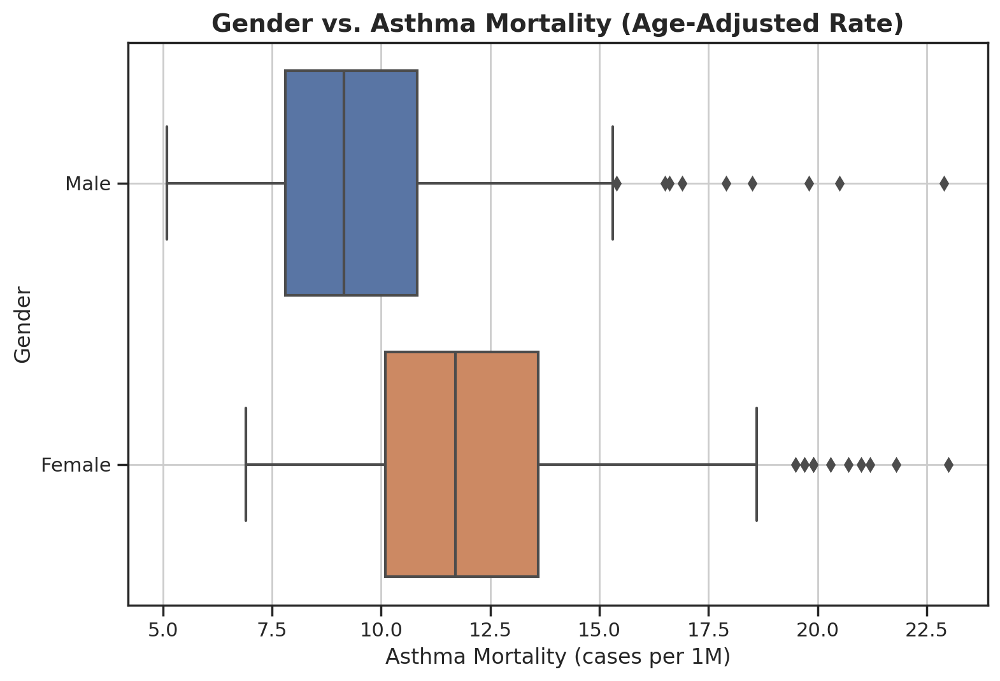

In [13]:
ax = sns.boxplot(x = 'DataValue', y = 'Stratification1', data = mortality_gender, orient='h')
ax.set(xlabel='Asthma Mortality (cases per 1M)', ylabel='Gender')
ax.set_title('Gender vs. Asthma Mortality (Age-Adjusted Rate)', fontweight='bold', fontsize= 14)
plt.grid()
plt.tight_layout()

# box_fig = ax.get_figure()
# box_fig.savefig('boxplot_gender_vs_asthma.png');

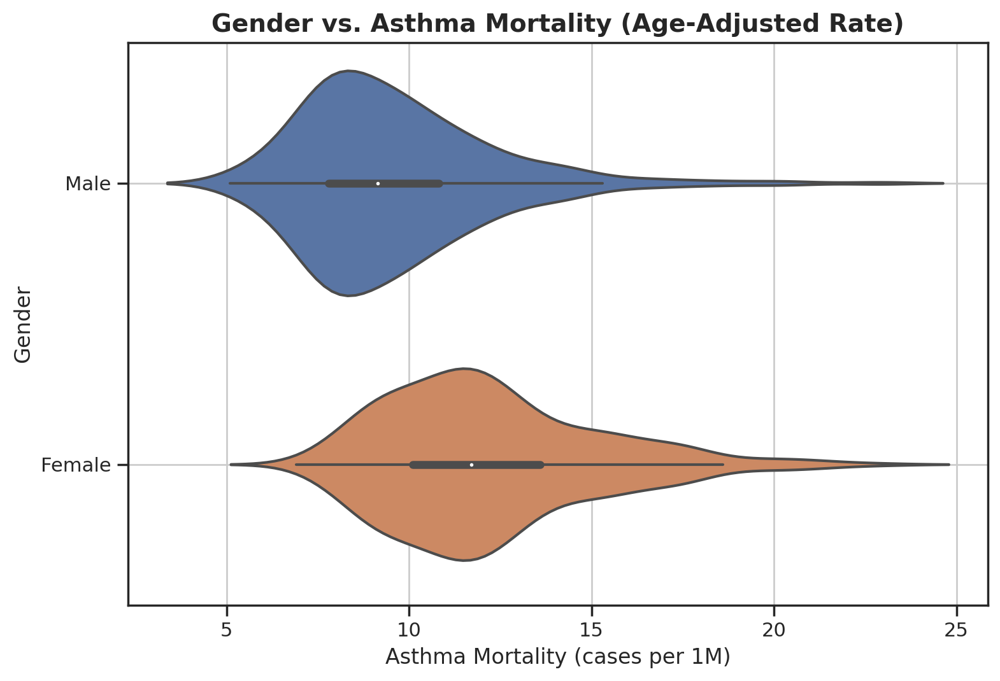

In [14]:
ax2 = sns.violinplot(x = 'DataValue', y = 'Stratification1', data = mortality_gender, orient='h')
ax2.set(xlabel='Asthma Mortality (cases per 1M)', ylabel='Gender')
ax2.set_title('Gender vs. Asthma Mortality (Age-Adjusted Rate)', fontweight='bold', fontsize= 14)
plt.grid()
plt.tight_layout()
# box_fig2 = ax2.get_figure()
# box_fig2.savefig('violinplot_gender_vs_asthma.png');

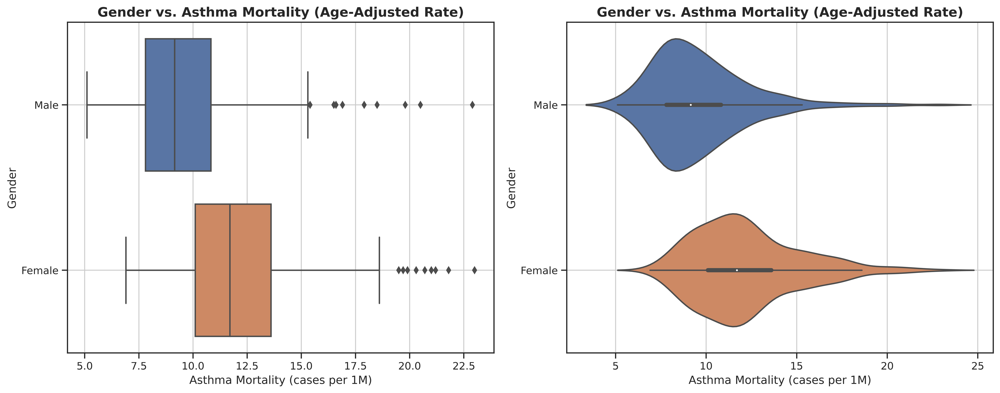

In [15]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(15, 6), dpi=300)

# First subplot (box plot)
sns.boxplot(x='DataValue', y='Stratification1', data=mortality_gender, orient='h', ax=ax1)
ax1.set(xlabel='Asthma Mortality (cases per 1M)', ylabel='Gender')
ax1.set_title('Gender vs. Asthma Mortality (Age-Adjusted Rate)', fontweight='bold', fontsize=14)
ax1.grid()

# Second subplot (violin plot)
sns.violinplot(x='DataValue', y='Stratification1', data=mortality_gender, orient='h', ax=ax2)
ax2.set(xlabel='Asthma Mortality (cases per 1M)', ylabel='Gender')
ax2.set_title('Gender vs. Asthma Mortality (Age-Adjusted Rate)', fontweight='bold', fontsize=14)
ax2.grid()
plt.tight_layout()

# plt.savefig('side_by_side_plot.png', dpi=300)

In [16]:
asthma_mortality = asthma.query('Question == "Asthma mortality rate" & DataValueType == "Age-adjusted Rate"')
asthma_mortality

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,Response,DataValueUnit,DataValueType,...,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1,StratificationCategoryID2,StratificationID2,StratificationCategoryID3,StratificationID3
9249,2020,2020,FL,Florida,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,12,AST,AST4_1,AGEADJRATE,GENDER,GENM,NaN,NaN,NaN,NaN
9260,2010,2010,IL,Illinois,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,17,AST,AST4_1,AGEADJRATE,RACE,AIAN,NaN,NaN,NaN,NaN
9276,2010,2010,CA,California,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,6,AST,AST4_1,AGEADJRATE,GENDER,GENM,NaN,NaN,NaN,NaN
9277,2017,2017,NM,New Mexico,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,35,AST,AST4_1,AGEADJRATE,RACE,API,NaN,NaN,NaN,NaN
9278,2013,2013,IL,Illinois,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,17,AST,AST4_1,AGEADJRATE,RACE,BLK,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28908,2014,2014,OH,Ohio,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,39,AST,AST4_1,AGEADJRATE,OVERALL,OVR,NaN,NaN,NaN,NaN
28909,2020,2020,VA,Virginia,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,51,AST,AST4_1,AGEADJRATE,OVERALL,OVR,NaN,NaN,NaN,NaN
28912,2014,2014,SC,South Carolina,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,45,AST,AST4_1,AGEADJRATE,GENDER,GENM,NaN,NaN,NaN,NaN
28913,2011,2011,TN,Tennessee,NVSS,Asthma,Asthma mortality rate,NaN,"cases per 1,000,000",Age-adjusted Rate,...,47,AST,AST4_1,AGEADJRATE,RACE,HIS,NaN,NaN,NaN,NaN


In [17]:
mortality_race = asthma_mortality.query('StratificationCategoryID1 == "RACE"')[['DataValue','Stratification1']]
mortality_race.dropna(inplace=True)

In [18]:
mortality_race

,DataValue,Stratification1
9278,47.4,"Black, non-Hispanic"
9279,18.3,Asian or Pacific Islander
9296,9.1,Hispanic
9358,8.3,"White, non-Hispanic"
9381,7.4,"White, non-Hispanic"
...,...,...
28846,7.4,"White, non-Hispanic"
28855,6.3,"White, non-Hispanic"
28856,8.3,"White, non-Hispanic"
28880,7.6,"White, non-Hispanic"


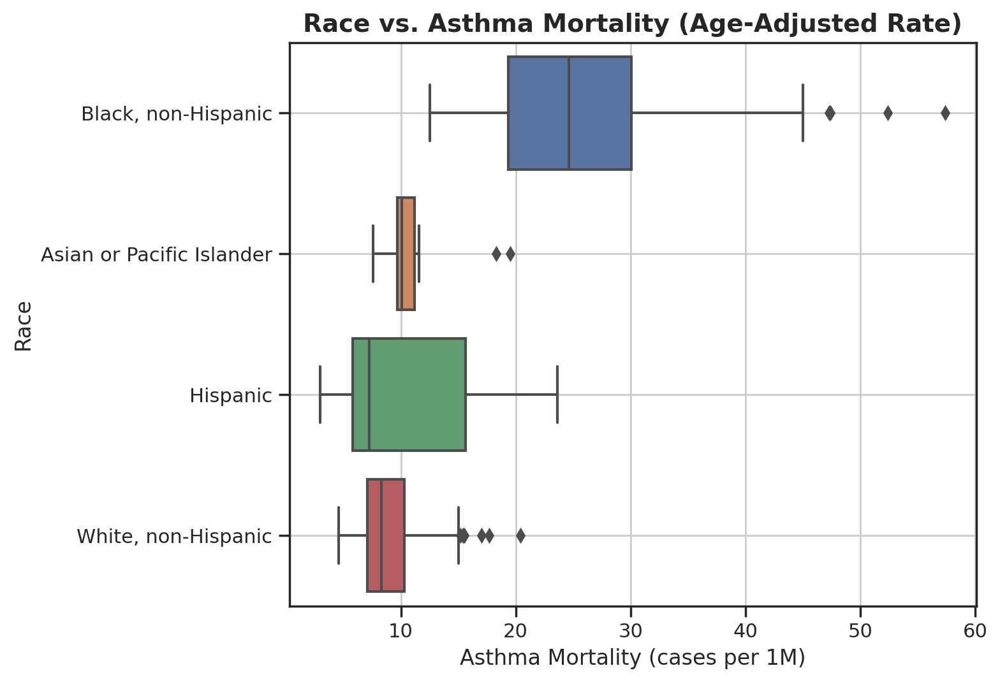

In [19]:
ax = sns.boxplot(x = 'DataValue', y = 'Stratification1', data = mortality_race, orient='h')
ax.set(xlabel='Asthma Mortality (cases per 1M)', ylabel='Race')
ax.set_title('Race vs. Asthma Mortality (Age-Adjusted Rate)', fontweight='bold', fontsize= 14)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
plt.grid()
plt.tight_layout()
# box_fig = ax.get_figure()
# box_fig.savefig('boxplot_race_vs_asthma.png');

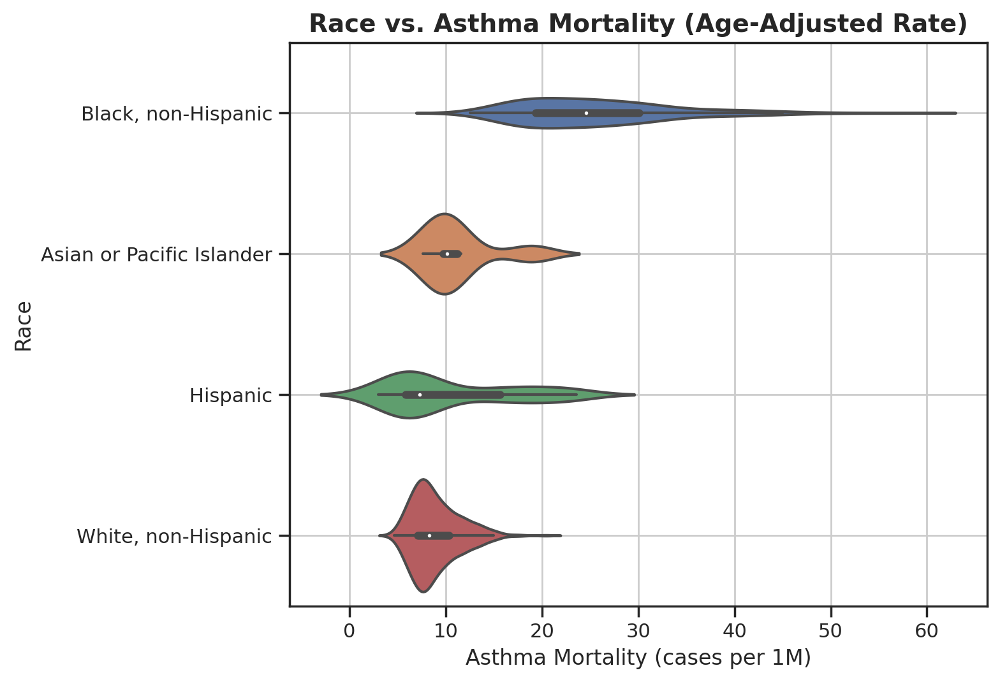

In [20]:
ax = sns.violinplot(x = 'DataValue', y = 'Stratification1', data = mortality_race, orient='h')
ax.set(xlabel='Asthma Mortality (cases per 1M)', ylabel='Race')
ax.set_title('Race vs. Asthma Mortality (Age-Adjusted Rate)', fontweight='bold', fontsize= 14)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
plt.grid()
plt.tight_layout()
# violin_fig = ax.get_figure()
# violin_fig.savefig('violin_race_vs_asthma.png');

In [21]:
asthma['Question'].unique()

array(['Hospitalizations for asthma', 'Asthma mortality rate',
       'Emergency department visit rate for asthma',
       'Asthma prevalence among women aged 18-44 years',
       'Current asthma prevalence among adults aged >= 18 years',
       'Influenza vaccination among noninstitutionalized adults aged >= 65 years with asthma',
       'Influenza vaccination among noninstitutionalized adults aged 18-64 years with asthma',
       'Pneumococcal vaccination among noninstitutionalized adults aged 18-64 years with asthma',
       'Pneumococcal vaccination among noninstitutionalized adults aged >= 65 years with asthma'],
      dtype=object)

In [22]:
asthma['StratificationCategoryID1'].unique()

array(['GENDER', 'OVERALL', 'RACE'], dtype=object)

In [23]:
asthma['DataValueType'].unique()

array(['Number', 'Crude Rate', 'Age-adjusted Rate', 'Crude Prevalence',
       'Age-adjusted Prevalence'], dtype=object)

In [24]:
asthma.query('Question == "Hospitalizations for asthma"')['DataValue'].dropna().describe

<bound method NDFrame.describe of 0         916.00
1        2227.00
2         708.00
3        3520.00
4         123.00
          ...   
24691    4715.00
24692    2164.00
24697       2.40
24700      14.37
24704       2.65
Name: DataValue, Length: 3507, dtype: float64>

## Quantitative Variable #1

In [25]:
asthma['StratificationCategoryID1']

0         GENDER
1        OVERALL
2        OVERALL
3         GENDER
4           RACE
          ...   
80337       RACE
80338       RACE
80339     GENDER
80340     GENDER
80341     GENDER
Name: StratificationCategoryID1, Length: 80342, dtype: object

In [26]:
morality_overall = asthma.query('DataValueType == "Age-adjusted Rate" &  Question == "Asthma mortality rate" & StratificationCategoryID1 == "OVERALL"')
influ_overall_65 = asthma.query('DataValueType == "Age-adjusted Prevalence" &  Question == "Influenza vaccination among noninstitutionalized adults aged >= 65 years with asthma" & StratificationCategoryID1 == "OVERALL"')
mortality_influ_65 = morality_overall.merge(influ_overall_65, how = 'inner', on = ['YearStart','LocationAbbr'], suffixes = ('_mortality','_senior'))
mortality_influ_65 = mortality_influ_65[['Question_mortality','DataValue_mortality','Question_senior','DataValue_senior']]
mortality_influ_65.dropna(inplace=True)
mortality_influ_65

,Question_mortality,DataValue_mortality,Question_senior,DataValue_senior
0,Asthma mortality rate,5.8,Influenza vaccination among noninstitutionaliz...,61.4
1,Asthma mortality rate,9.5,Influenza vaccination among noninstitutionaliz...,62.6
2,Asthma mortality rate,12.4,Influenza vaccination among noninstitutionaliz...,67.2
3,Asthma mortality rate,10.3,Influenza vaccination among noninstitutionaliz...,72.8
4,Asthma mortality rate,8.3,Influenza vaccination among noninstitutionaliz...,55.1
...,...,...,...,...
514,Asthma mortality rate,8.7,Influenza vaccination among noninstitutionaliz...,62.7
516,Asthma mortality rate,11.0,Influenza vaccination among noninstitutionaliz...,68.8
517,Asthma mortality rate,13.6,Influenza vaccination among noninstitutionaliz...,71.0
518,Asthma mortality rate,9.1,Influenza vaccination among noninstitutionaliz...,64.8


In [27]:
morality_overall = asthma.query('DataValueType == "Age-adjusted Rate" &  Question == "Asthma mortality rate" & StratificationCategoryID1 == "OVERALL"')
influ_overall_18 = asthma.query('DataValueType == "Age-adjusted Prevalence" &  Question == "Influenza vaccination among noninstitutionalized adults aged 18-64 years with asthma" & StratificationCategoryID1 == "OVERALL"')
mortality_influ_18 = morality_overall.merge(influ_overall_18, how = 'inner', on = ['YearStart','LocationAbbr'], suffixes = ('_mortality','_adult'))
mortality_influ_18 = mortality_influ_18[['Question_mortality','DataValue_mortality','Question_adult','DataValue_adult']]
mortality_influ_18.dropna(inplace=True)
mortality_influ_18

,Question_mortality,DataValue_mortality,Question_adult,DataValue_adult
0,Asthma mortality rate,5.8,Influenza vaccination among noninstitutionaliz...,37.6
1,Asthma mortality rate,9.5,Influenza vaccination among noninstitutionaliz...,41.2
2,Asthma mortality rate,12.4,Influenza vaccination among noninstitutionaliz...,44.5
3,Asthma mortality rate,10.3,Influenza vaccination among noninstitutionaliz...,37.4
4,Asthma mortality rate,8.3,Influenza vaccination among noninstitutionaliz...,38.9
...,...,...,...,...
514,Asthma mortality rate,8.7,Influenza vaccination among noninstitutionaliz...,41.8
516,Asthma mortality rate,11.0,Influenza vaccination among noninstitutionaliz...,38.0
517,Asthma mortality rate,13.6,Influenza vaccination among noninstitutionaliz...,42.2
518,Asthma mortality rate,9.1,Influenza vaccination among noninstitutionaliz...,37.3


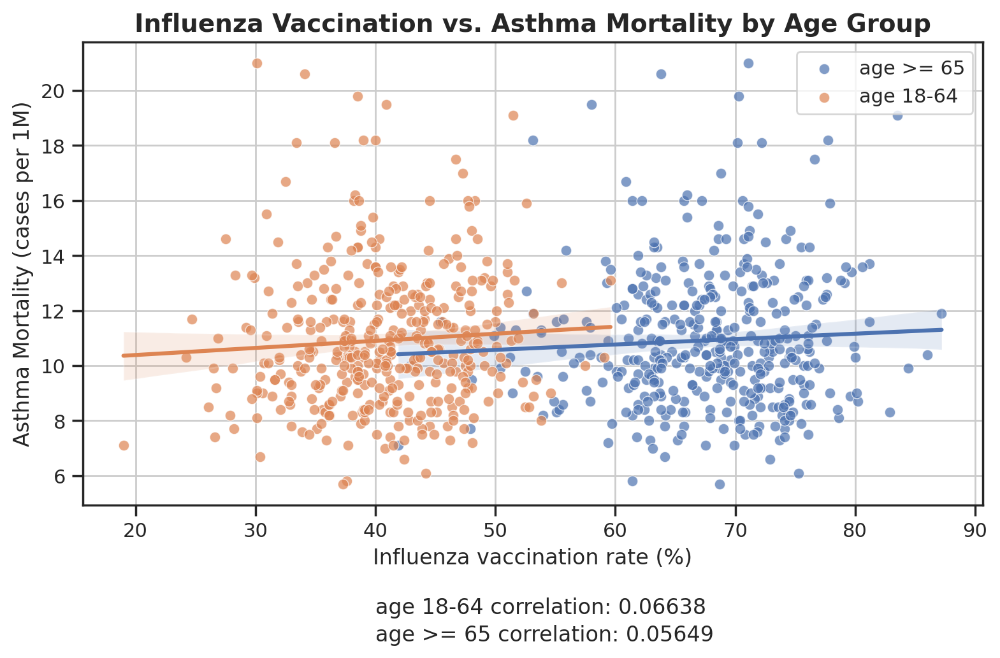

In [28]:
# Plot the data points for age >= 65
sns.scatterplot(data=mortality_influ_65, x='DataValue_senior', y='DataValue_mortality', alpha=0.7, label='age >= 65')

# Plot the regression line for age >= 65
sns.regplot(data=mortality_influ_65, x='DataValue_senior', y='DataValue_mortality', scatter=False)

# Plot the data points for age 18-64
sns.scatterplot(data=mortality_influ_18, x='DataValue_adult', y='DataValue_mortality', alpha=0.7, label='age 18-64')

# Plot the regression line for age 18-64
sns.regplot(data=mortality_influ_18, x='DataValue_adult', y='DataValue_mortality', scatter=False)

correlation_65 = mortality_influ_65['DataValue_senior'].corr(mortality_influ_65['DataValue_mortality'])
plt.text(40,0,'age >= 65 correlation: '+ str(round(correlation_65, 5)));
correlation_18 = mortality_influ_18['DataValue_adult'].corr(mortality_influ_18['DataValue_mortality'])
plt.text(40,1,'age 18-64 correlation: '+ str(round(correlation_18, 5)))

# Set the axis labels and title
plt.xlabel('Influenza vaccination rate (%)')
plt.ylabel('Asthma Mortality (cases per 1M)')
plt.title('Influenza Vaccination vs. Asthma Mortality by Age Group', fontweight='bold', fontsize= 14)

# Add a legend
plt.legend()

# Show the plot
plt.tight_layout()
plt.grid()

# plt.savefig('age_group_influe.png', dpi=300)
# plt.show()

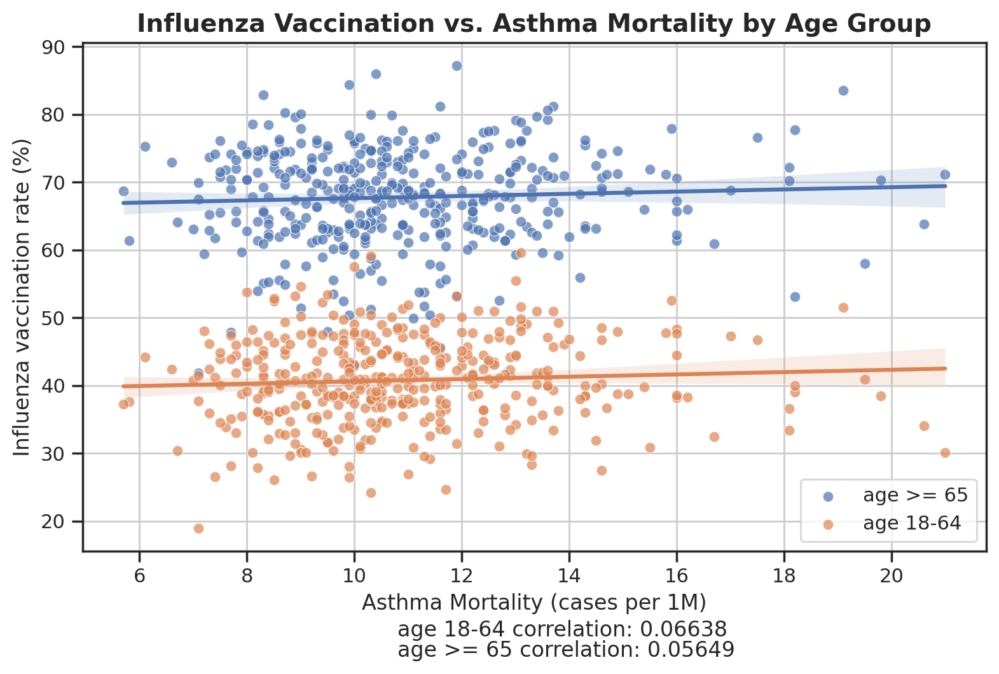

In [29]:
# Plot the data points for age >= 65
sns.scatterplot(data=mortality_influ_65, x='DataValue_mortality', y='DataValue_senior', alpha=0.7, label='age >= 65')

# Plot the regression line for age >= 65
sns.regplot(data=mortality_influ_65, x='DataValue_mortality', y='DataValue_senior', scatter=False)

# Plot the data points for age 18-64
sns.scatterplot(data=mortality_influ_18, x='DataValue_mortality', y='DataValue_adult', alpha=0.7, label='age 18-64')

# Plot the regression line for age 18-64
sns.regplot(data=mortality_influ_18, x='DataValue_mortality', y='DataValue_adult', scatter=False)

correlation_65 = mortality_influ_65['DataValue_senior'].corr(mortality_influ_65['DataValue_mortality'])
plt.text(10.8, 0,'age >= 65 correlation: '+ str(round(correlation_65, 5)));
correlation_18 = mortality_influ_18['DataValue_adult'].corr(mortality_influ_18['DataValue_mortality'])
plt.text(10.8, 3,'age 18-64 correlation: '+ str(round(correlation_18, 5)))

# Set the axis labels and title
plt.xlabel('Asthma Mortality (cases per 1M)')
plt.ylabel('Influenza vaccination rate (%)')
plt.title('Influenza Vaccination vs. Asthma Mortality by Age Group', fontweight='bold', fontsize= 14)

# Add a legend
plt.legend()

# Show the plot
plt.tight_layout()
plt.grid()

# plt.savefig('age_group_influe.png', dpi=300)
# plt.show()

## Quantitative Variable #2

In [30]:
morality_overall = asthma.query('DataValueType == "Age-adjusted Rate" &  Question == "Asthma mortality rate" & StratificationCategoryID1 == "OVERALL"')
pneu_overall_65 = asthma.query('DataValueType == "Age-adjusted Prevalence" &  Question == "Pneumococcal vaccination among noninstitutionalized adults aged >= 65 years with asthma" & StratificationCategoryID1 == "OVERALL"')
mortality_pneu_65 = morality_overall.merge(pneu_overall_65, how = 'inner', on = ['YearStart','LocationAbbr'], suffixes = ('_mortality','_senior'))
mortality_pneu_65 = mortality_pneu_65[['Question_mortality','DataValue_mortality','Question_senior','DataValue_senior']]
mortality_pneu_65.dropna(inplace=True)
mortality_pneu_65

,Question_mortality,DataValue_mortality,Question_senior,DataValue_senior
0,Asthma mortality rate,5.8,Pneumococcal vaccination among noninstitutiona...,81.4
1,Asthma mortality rate,9.5,Pneumococcal vaccination among noninstitutiona...,83.9
2,Asthma mortality rate,12.4,Pneumococcal vaccination among noninstitutiona...,85.7
3,Asthma mortality rate,10.3,Pneumococcal vaccination among noninstitutiona...,86.3
4,Asthma mortality rate,8.3,Pneumococcal vaccination among noninstitutiona...,84.1
...,...,...,...,...
514,Asthma mortality rate,8.7,Pneumococcal vaccination among noninstitutiona...,94.0
516,Asthma mortality rate,11.0,Pneumococcal vaccination among noninstitutiona...,83.4
517,Asthma mortality rate,13.6,Pneumococcal vaccination among noninstitutiona...,88.9
518,Asthma mortality rate,9.1,Pneumococcal vaccination among noninstitutiona...,82.5


In [31]:
morality_overall = asthma.query('DataValueType == "Age-adjusted Rate" &  Question == "Asthma mortality rate" & StratificationCategoryID1 == "OVERALL"')
pneu_overall_18 = asthma.query('DataValueType == "Age-adjusted Prevalence" &  Question == "Pneumococcal vaccination among noninstitutionalized adults aged 18-64 years with asthma" & StratificationCategoryID1 == "OVERALL"')
mortality_pneu_18 = morality_overall.merge(pneu_overall_18, how = 'inner', on = ['YearStart','LocationAbbr'], suffixes = ('_mortality','_adult'))
mortality_pneu_18 = mortality_pneu_18[['Question_mortality','DataValue_mortality','Question_adult','DataValue_adult']]
mortality_pneu_18.dropna(inplace=True)
mortality_pneu_18

,Question_mortality,DataValue_mortality,Question_adult,DataValue_adult
0,Asthma mortality rate,5.8,Pneumococcal vaccination among noninstitutiona...,36.6
1,Asthma mortality rate,9.5,Pneumococcal vaccination among noninstitutiona...,43.0
2,Asthma mortality rate,12.4,Pneumococcal vaccination among noninstitutiona...,36.0
3,Asthma mortality rate,10.3,Pneumococcal vaccination among noninstitutiona...,38.5
4,Asthma mortality rate,8.3,Pneumococcal vaccination among noninstitutiona...,36.6
...,...,...,...,...
514,Asthma mortality rate,8.7,Pneumococcal vaccination among noninstitutiona...,49.8
516,Asthma mortality rate,11.0,Pneumococcal vaccination among noninstitutiona...,39.6
517,Asthma mortality rate,13.6,Pneumococcal vaccination among noninstitutiona...,44.3
518,Asthma mortality rate,9.1,Pneumococcal vaccination among noninstitutiona...,40.3


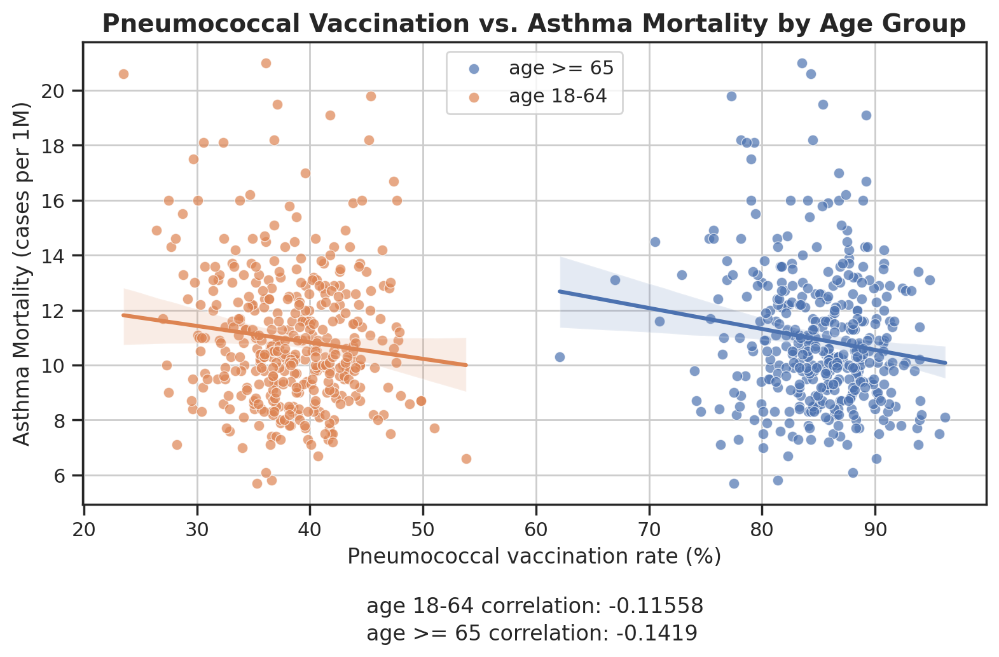

In [32]:
# Plot the data points for age >= 65
sns.scatterplot(data=mortality_pneu_65, x='DataValue_senior', y='DataValue_mortality', alpha=0.7, label='age >= 65')

# Plot the regression line for age >= 65
sns.regplot(data=mortality_pneu_65, x='DataValue_senior', y='DataValue_mortality', scatter=False)

# Plot the data points for age 18-64
sns.scatterplot(data=mortality_pneu_18, x='DataValue_adult', y='DataValue_mortality', alpha=0.7, label='age 18-64')

# Plot the regression line for age 18-64
sns.regplot(data=mortality_pneu_18, x='DataValue_adult', y='DataValue_mortality', scatter=False)

correlation_65 = mortality_pneu_65['DataValue_senior'].corr(mortality_pneu_65['DataValue_mortality'])
plt.text(45,0,'age >= 65 correlation: '+ str(round(correlation_65, 5)));
correlation_18 = mortality_pneu_18['DataValue_adult'].corr(mortality_pneu_18['DataValue_mortality'])
plt.text(45,1,'age 18-64 correlation: '+ str(round(correlation_18, 5)))

# Set the axis labels and title
plt.xlabel('Pneumococcal vaccination rate (%)')
plt.ylabel('Asthma Mortality (cases per 1M)')
plt.title('Pneumococcal Vaccination vs. Asthma Mortality by Age Group', fontweight='bold', fontsize= 14)

# Add a legend
plt.legend()

# Show the plot
plt.tight_layout()
plt.grid()

# plt.savefig('age_group_pneum.png', dpi=300)
# plt.show()

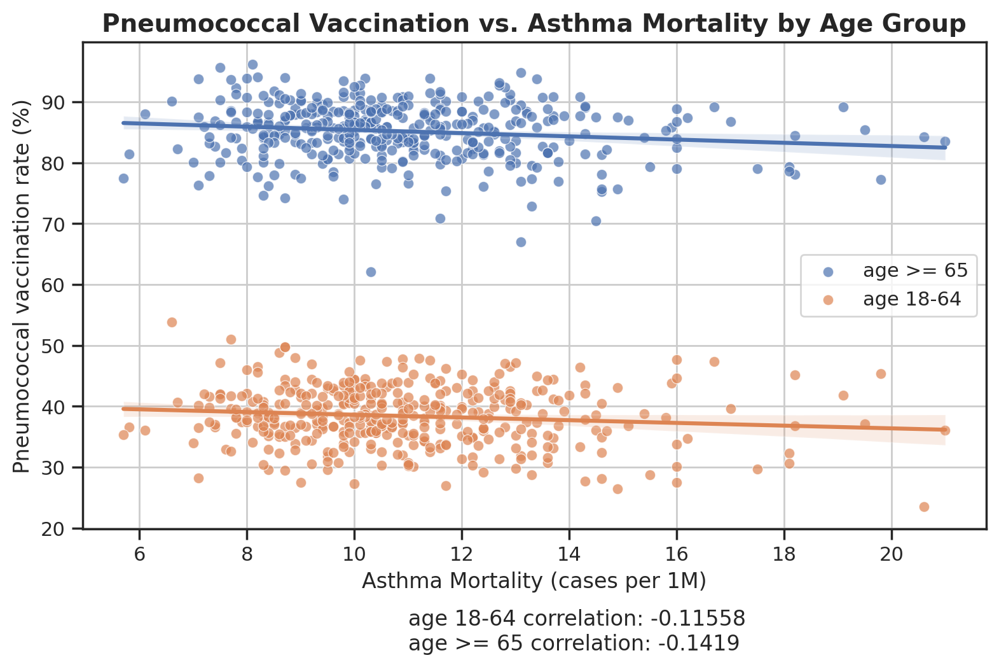

In [33]:
# Plot the data points for age >= 65
sns.scatterplot(data=mortality_pneu_65, x='DataValue_mortality', y= 'DataValue_senior', alpha=0.7, label='age >= 65')

# Plot the regression line for age >= 65
sns.regplot(data=mortality_pneu_65, x='DataValue_mortality', y= 'DataValue_senior', scatter=False)

# Plot the data points for age 18-64
sns.scatterplot(data=mortality_pneu_18, x='DataValue_mortality', y='DataValue_adult', alpha=0.7, label='age 18-64')

# Plot the regression line for age 18-64
sns.regplot(data=mortality_pneu_18, x='DataValue_mortality', y='DataValue_adult', scatter=False)

correlation_65 = mortality_pneu_65['DataValue_senior'].corr(mortality_pneu_65['DataValue_mortality'])
plt.text(11,0,'age >= 65 correlation: '+ str(round(correlation_65, 5)));
correlation_18 = mortality_pneu_18['DataValue_adult'].corr(mortality_pneu_18['DataValue_mortality'])
plt.text(11, 4,'age 18-64 correlation: '+ str(round(correlation_18, 5)))

# Set the axis labels and title
plt.xlabel('Asthma Mortality (cases per 1M)')
plt.ylabel('Pneumococcal vaccination rate (%)')
plt.title('Pneumococcal Vaccination vs. Asthma Mortality by Age Group', fontweight='bold', fontsize= 14)

# Add a legend
plt.legend()

# Show the plot
plt.tight_layout()
plt.grid()

# plt.savefig('age_group_pneum.png', dpi=300)
# plt.show()

In [ ]:
# Data Preparation

In [34]:
asthma_original = pd.read_csv("us_chronic_asthma.csv")
c2010 = pd.read_csv("2010.csv")
c2011 = pd.read_csv("2011.csv")
c2012 = pd.read_csv("2012.csv")
c2013 = pd.read_csv("2013.csv")
c2014 = pd.read_csv("2014.csv")
c2015 = pd.read_csv("2015.csv")
c2016 = pd.read_csv("2016.csv")
c2017 = pd.read_csv("2017.csv")
c2018 = pd.read_csv("2018.csv")
c2019 = pd.read_csv("2019.csv")
c2021 = pd.read_csv("2021.csv")

In [35]:
def add_column(df, colName, val):
    df[colName] = [val]*(df.shape[0])
    return df

### Add `year` Column in census dataframe

In [36]:
c2010 = add_column(c2010,'year',2010)
c2011 = add_column(c2011,'year',2011)
c2012 = add_column(c2012,'year',2012)
c2013 = add_column(c2013,'year',2013)
c2014 = add_column(c2014,'year',2014)
c2015 = add_column(c2015,'year',2015)
c2016 = add_column(c2016,'year',2016)
c2017 = add_column(c2017,'year',2017)
c2018 = add_column(c2018,'year',2018)
c2019 = add_column(c2019,'year',2019)
c2021 = add_column(c2021,'year',2021)

### Append 2010-2021 census data into one dataframe: `census`

In [37]:
census_lst = [c2010,c2011,c2012,c2013,c2014,c2015,c2016,c2017,c2018,c2019,c2021]
census = pd.concat(census_lst)
census

,state,high_sch_grad_PE,bachelor's_PE,cpt_web_E,cpt_PE,web_PE,employ_16_over_E,unemployed_PE,commute_16_over_E,commute_walked_PE,...,median_age_E,white_PE,black_PE,native_PE,asian_PE,hispanic_PE,total_occupied_house_E,house_heat_coal_PE,house_heat_wood_PE,year
0,Alabama,31.3,13.9,NaN,NaN,NaN,3785555,11.8,1951769,1.3,...,37.8,69.5,26.4,0.6,1.1,3.8,1815152,0.0,1.1,2010
1,Alaska,25.3,18.5,NaN,NaN,NaN,546981,9.6,343424,7.9,...,33.8,67.4,3.5,14.6,5.5,5.7,254610,0.2,5.5,2010
2,Arizona,25.1,16.7,NaN,NaN,NaN,4963740,11.8,2621839,2.0,...,35.9,79.4,4.1,4.5,2.7,29.8,2334050,0.0,2.1,2010
3,Arkansas,34.6,13.2,NaN,NaN,NaN,2290670,9.6,1225968,1.8,...,37.3,78.4,15.9,0.6,1.1,6.3,1114902,0.0,4.4,2010
4,California,20.8,19.1,NaN,NaN,NaN,29159527,12.8,15921475,2.7,...,35.2,62.4,6.0,0.8,13.1,37.7,12406475,0.0,1.8,2010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47,Washington,21.6,39.0,3022255.0,96.9,93.5,6250868,5.9,3668157,2.8,...,38.2,66.4,4.0,1.3,9.5,13.7,3022255,0.0,2.9,2021
48,West Virginia,39.1,24.1,722201.0,90.3,85.0,1465755,6.2,707299,2.1,...,42.8,90.7,2.8,0.1,0.8,1.7,722201,0.3,5.1,2021
49,Wisconsin,30.0,32.5,2449970.0,94.3,89.6,4773326,3.5,2945351,2.7,...,40.1,80.3,6.2,0.7,3.0,7.5,2449970,0.0,2.8,2021
50,Wyoming,27.3,29.2,242763.0,95.4,90.3,461622,3.7,283628,3.4,...,39.0,84.6,1.2,1.8,0.9,10.6,242763,0.2,3.9,2021


In [38]:
asthma_original.columns

Index(['YearStart', 'YearEnd', 'LocationAbbr', 'LocationDesc', 'DataSource',
       'Topic', 'Question', 'Response', 'DataValueUnit', 'DataValueType',
       'DataValue', 'DataValueAlt', 'DataValueFootnoteSymbol',
       'DatavalueFootnote', 'LowConfidenceLimit', 'HighConfidenceLimit',
       'StratificationCategory1', 'Stratification1', 'StratificationCategory2',
       'Stratification2', 'StratificationCategory3', 'Stratification3',
       'ResponseID', 'LocationID', 'TopicID', 'QuestionID', 'DataValueTypeID',
       'StratificationCategoryID1', 'StratificationID1',
       'StratificationCategoryID2', 'StratificationID2',
       'StratificationCategoryID3', 'StratificationID3'],
      dtype='object')

In [39]:
asthma_original['DataValueType'].unique()

array(['Number', 'Crude Rate', 'Age-adjusted Rate', 'Crude Prevalence',
       'Age-adjusted Prevalence'], dtype=object)

### Filter `Age-adjusted Rate`

In [40]:
asthma = asthma_original[['YearStart','LocationDesc','Question', 'DataValueType','DataValue','StratificationCategoryID1','StratificationID1']]
asthma = asthma.dropna()
age_adjusted_asthma = asthma[(asthma['DataValueType'] == 'Age-adjusted Prevalence') | (asthma['DataValueType'] == 'Age-adjusted Rate')]
age_adjusted_asthma


,YearStart,LocationDesc,Question,DataValueType,DataValue,StratificationCategoryID1,StratificationID1
40,2017,Arizona,Hospitalizations for asthma,Age-adjusted Rate,4.39,RACE,HIS
77,2016,Nevada,Emergency department visit rate for asthma,Age-adjusted Rate,21.60,RACE,API
90,2017,Georgia,Emergency department visit rate for asthma,Age-adjusted Rate,93.90,RACE,BLK
108,2015,Arkansas,Hospitalizations for asthma,Age-adjusted Rate,6.91,OVERALL,OVR
109,2016,North Carolina,Emergency department visit rate for asthma,Age-adjusted Rate,49.04,GENDER,GENM
...,...,...,...,...,...,...,...
80329,2020,Wyoming,Influenza vaccination among noninstitutionaliz...,Age-adjusted Prevalence,36.70,OVERALL,OVR
80331,2020,Wyoming,Current asthma prevalence among adults aged >=...,Age-adjusted Prevalence,7.60,GENDER,GENM
80332,2020,Wyoming,Pneumococcal vaccination among noninstitutiona...,Age-adjusted Prevalence,34.20,OVERALL,OVR
80335,2020,Wyoming,Pneumococcal vaccination among noninstitutiona...,Age-adjusted Prevalence,36.30,GENDER,GENF


### Pivot `age_adjusted asthma` on `StratificationID1`

In [41]:
pivot_tbl = pd.pivot_table(
    age_adjusted_asthma, index = ['YearStart','LocationDesc','Question'], columns = ['StratificationID1'], values = 'DataValue'
)
pivot_tbl = pivot_tbl.reset_index() 
pivot_tbl


StratificationID1,YearStart,LocationDesc,Question,AIAN,API,BLK,GENF,GENM,HIS,MRC,OTH,OVR,WHT
0,2010,Alabama,Asthma mortality rate,NaN,NaN,20.40,15.40,NaN,NaN,NaN,NaN,11.90,9.60
1,2010,Arizona,Asthma mortality rate,NaN,NaN,NaN,8.80,8.20,NaN,NaN,NaN,8.60,8.60
2,2010,Arizona,Emergency department visit rate for asthma,NaN,NaN,NaN,70.08,57.27,NaN,NaN,NaN,63.95,NaN
3,2010,Arizona,Hospitalizations for asthma,11.62,5.71,34.53,14.20,10.38,10.43,NaN,NaN,12.40,12.18
4,2010,Arkansas,Asthma mortality rate,NaN,NaN,NaN,15.90,NaN,NaN,NaN,NaN,11.40,10.40
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3660,2021,Wyoming,Current asthma prevalence among adults aged >=...,NaN,NaN,NaN,12.30,7.10,6.00,22.4,NaN,9.60,9.50
3661,2021,Wyoming,Influenza vaccination among noninstitutionaliz...,NaN,NaN,NaN,33.20,25.50,NaN,NaN,NaN,29.80,34.20
3662,2021,Wyoming,Influenza vaccination among noninstitutionaliz...,NaN,NaN,NaN,65.70,56.90,NaN,NaN,NaN,62.50,61.10
3663,2021,Wyoming,Pneumococcal vaccination among noninstitutiona...,NaN,NaN,NaN,33.70,31.40,NaN,NaN,NaN,32.80,27.40


### Merge `age_adjusted asthma` and `census`. Filter `Asthma mortality rate`. Drop duplicated columns

In [42]:
data = pd.merge(pivot_tbl,census,how = 'inner',left_on = ['YearStart','LocationDesc'], right_on=['year','state'])
data = data.drop(['state','year'],axis = 1)
data = data.rename(columns={"YearStart": "year", "LocationDesc": "state"})
data_mortality = data[data['Question'] == "Asthma mortality rate"]
data_mortality.columns

Index(['year', 'state', 'Question', 'AIAN', 'API', 'BLK', 'GENF', 'GENM',
       'HIS', 'MRC', 'OTH', 'OVR', 'WHT', 'high_sch_grad_PE', 'bachelor's_PE',
       'cpt_web_E', 'cpt_PE', 'web_PE', 'employ_16_over_E', 'unemployed_PE',
       'commute_16_over_E', 'commute_walked_PE', 'commute_worked_home_PE',
       'occup_construct_PE', 'occup_transp_PE', 'occup_agric_PE',
       'industry_construct_PE', 'industry_manufacture_PE',
       'industry_transport_PE', 'worker_employed_16_over_E', 'income_median_E',
       'health_insure_pop_', 'health_insure_19_64_E',
       'health_insure_unemployed_E', 'proverty_familiy_PE',
       'proverty_people_P', 'house_heat_coal_E', 'pop_total_E', 'male_PE',
       'female_PE', 'age_under_5_PE', 'age_5_9_PE', 'median_age_E', 'white_PE',
       'black_PE', 'native_PE', 'asian_PE', 'hispanic_PE',
       'total_occupied_house_E', 'house_heat_coal_PE', 'house_heat_wood_PE'],
      dtype='object')

### Many `DataValue` in `age_adjusted asthma` is NaN. Drop them and only consider `OVR` (overall motality rate)

In [43]:
data_mortality = data_mortality.drop(columns=['AIAN', 'API', 'BLK', 'GENF',
       'GENM', 'HIS', 'MRC', 'OTH','WHT','cpt_web_E','cpt_PE','web_PE'])

In [44]:
data_mortality.columns

Index(['year', 'state', 'Question', 'OVR', 'high_sch_grad_PE', 'bachelor's_PE',
       'employ_16_over_E', 'unemployed_PE', 'commute_16_over_E',
       'commute_walked_PE', 'commute_worked_home_PE', 'occup_construct_PE',
       'occup_transp_PE', 'occup_agric_PE', 'industry_construct_PE',
       'industry_manufacture_PE', 'industry_transport_PE',
       'worker_employed_16_over_E', 'income_median_E', 'health_insure_pop_',
       'health_insure_19_64_E', 'health_insure_unemployed_E',
       'proverty_familiy_PE', 'proverty_people_P', 'house_heat_coal_E',
       'pop_total_E', 'male_PE', 'female_PE', 'age_under_5_PE', 'age_5_9_PE',
       'median_age_E', 'white_PE', 'black_PE', 'native_PE', 'asian_PE',
       'hispanic_PE', 'total_occupied_house_E', 'house_heat_coal_PE',
       'house_heat_wood_PE'],
      dtype='object')

### Only consider PE (percentage)

In [45]:
data_mortality = data_mortality.drop(columns = ['employ_16_over_E','commute_16_over_E','worker_employed_16_over_E','health_insure_pop_',
       'health_insure_19_64_E', 'health_insure_unemployed_E','house_heat_coal_E',
       'pop_total_E','total_occupied_house_E','income_median_E'])
data_mortality 

,year,state,Question,OVR,high_sch_grad_PE,bachelor's_PE,unemployed_PE,commute_walked_PE,commute_worked_home_PE,occup_construct_PE,...,age_under_5_PE,age_5_9_PE,median_age_E,white_PE,black_PE,native_PE,asian_PE,hispanic_PE,house_heat_coal_PE,house_heat_wood_PE
0,2010,Alabama,Asthma mortality rate,11.9,31.3,13.9,11.8,1.3,2.9,10.5,...,6.4,6.5,37.8,69.5,26.4,0.6,1.1,3.8,0.0,1.1
1,2010,Arizona,Asthma mortality rate,8.6,25.1,16.7,11.8,2.0,5.8,8.9,...,7.1,7.0,35.9,79.4,4.1,4.5,2.7,29.8,0.0,2.1
4,2010,Arkansas,Asthma mortality rate,11.4,34.6,13.2,9.6,1.8,3.0,10.9,...,6.7,6.7,37.3,78.4,15.9,0.6,1.1,6.3,0.0,4.4
6,2010,California,Asthma mortality rate,11.0,20.8,19.1,12.8,2.7,5.2,9.4,...,6.8,6.8,35.2,62.4,6.0,0.8,13.1,37.7,0.0,1.8
9,2010,Colorado,Asthma mortality rate,10.2,22.8,23.4,9.9,3.0,6.4,9.4,...,6.8,7.0,36.0,83.3,3.9,1.0,2.6,20.8,0.1,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2966,2019,Texas,Asthma mortality rate,7.1,25.2,30.8,4.4,1.5,5.7,10.6,...,6.8,6.9,35.1,73.4,12.3,0.5,5.0,39.7,0.0,0.3
2972,2019,Utah,Asthma mortality rate,9.4,23.1,34.8,3.2,2.0,7.4,9.4,...,7.7,8.0,31.2,87.3,1.2,1.1,2.4,14.4,0.1,1.1
2983,2019,Virginia,Asthma mortality rate,10.1,23.6,39.6,4.0,2.3,5.8,7.8,...,5.9,5.9,38.5,67.0,19.4,0.3,6.6,9.7,0.0,1.9
2989,2019,Washington,Asthma mortality rate,9.5,22.1,37.0,4.6,3.5,6.5,9.6,...,6.0,6.0,37.9,74.2,4.0,1.4,9.0,13.0,0.0,3.7


# Visualize mortality rate

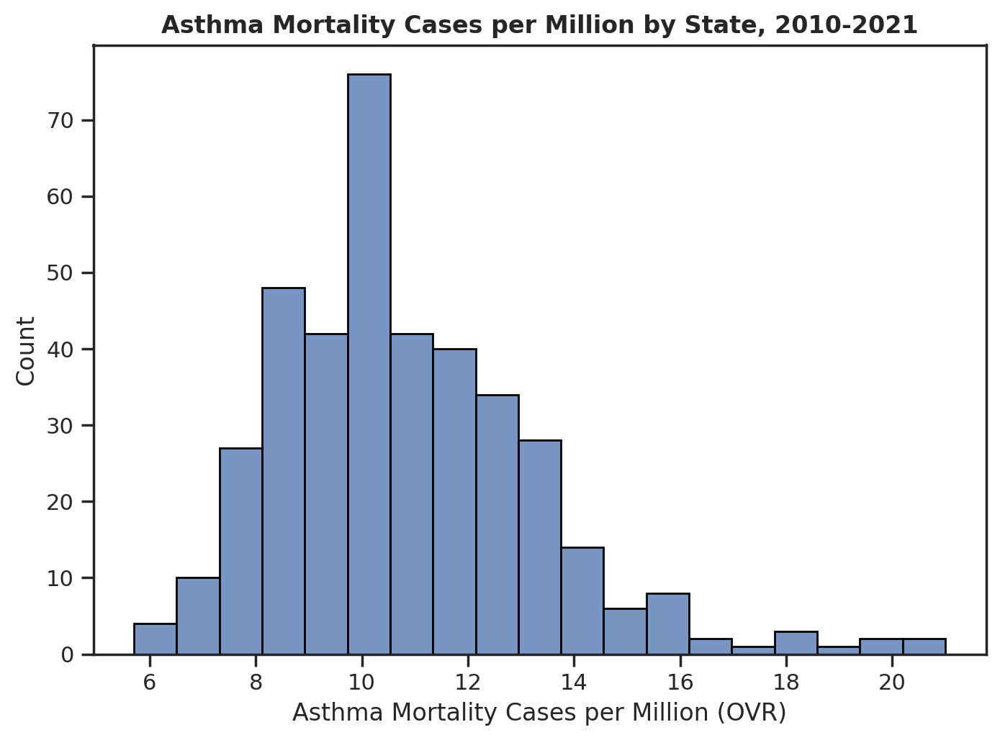

In [46]:
sns.histplot(data_mortality, x = 'OVR', edgecolor='black')
plt.title("Asthma Mortality Cases per Million by State, 2010-2021", fontweight="bold")
plt.xlabel("Asthma Mortality Cases per Million (OVR)")
plt.tight_layout;

### Scale `OVR` and make it looks like Normal Distribution for assumptions

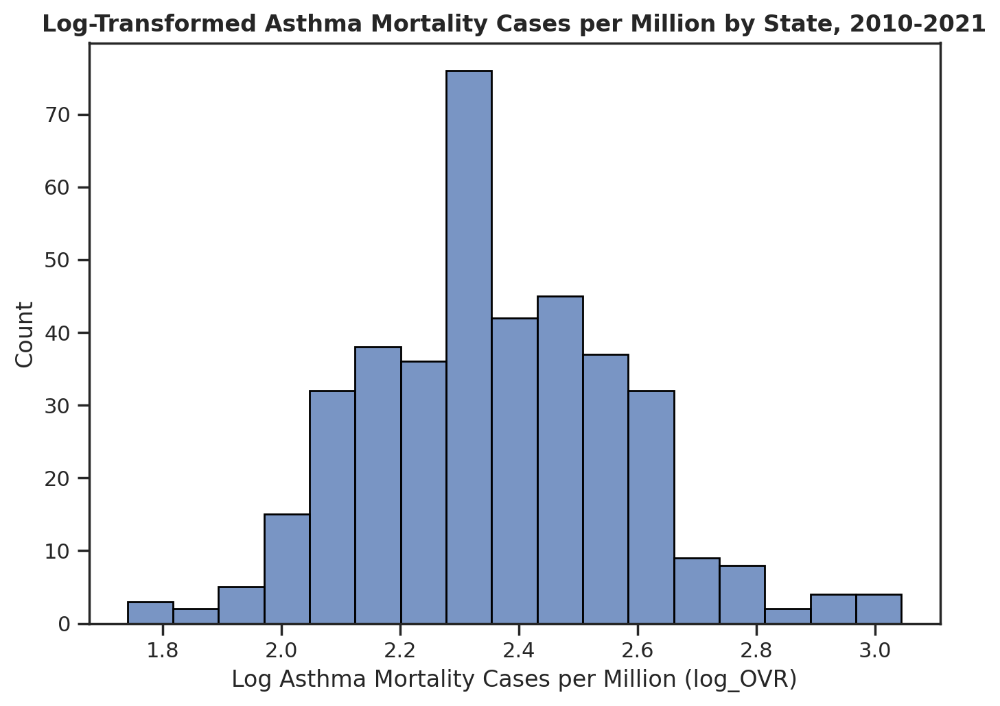

In [47]:
sns.histplot(np.log(data_mortality['OVR']), edgecolor='black')
plt.title("Log-Transformed Asthma Mortality Cases per Million by State, 2010-2021", fontweight="bold")
plt.xlabel("Log Asthma Mortality Cases per Million (log_OVR)")
plt.tight_layout;

In [48]:
# add in log scale OVR
data_mortality['log_OVR'] = np.log(data_mortality['OVR'])
data_mortality

,year,state,Question,OVR,high_sch_grad_PE,bachelor's_PE,unemployed_PE,commute_walked_PE,commute_worked_home_PE,occup_construct_PE,...,age_5_9_PE,median_age_E,white_PE,black_PE,native_PE,asian_PE,hispanic_PE,house_heat_coal_PE,house_heat_wood_PE,log_OVR
0,2010,Alabama,Asthma mortality rate,11.9,31.3,13.9,11.8,1.3,2.9,10.5,...,6.5,37.8,69.5,26.4,0.6,1.1,3.8,0.0,1.1,2.476538
1,2010,Arizona,Asthma mortality rate,8.6,25.1,16.7,11.8,2.0,5.8,8.9,...,7.0,35.9,79.4,4.1,4.5,2.7,29.8,0.0,2.1,2.151762
4,2010,Arkansas,Asthma mortality rate,11.4,34.6,13.2,9.6,1.8,3.0,10.9,...,6.7,37.3,78.4,15.9,0.6,1.1,6.3,0.0,4.4,2.433613
6,2010,California,Asthma mortality rate,11.0,20.8,19.1,12.8,2.7,5.2,9.4,...,6.8,35.2,62.4,6.0,0.8,13.1,37.7,0.0,1.8,2.397895
9,2010,Colorado,Asthma mortality rate,10.2,22.8,23.4,9.9,3.0,6.4,9.4,...,7.0,36.0,83.3,3.9,1.0,2.6,20.8,0.1,2.0,2.322388
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2966,2019,Texas,Asthma mortality rate,7.1,25.2,30.8,4.4,1.5,5.7,10.6,...,6.9,35.1,73.4,12.3,0.5,5.0,39.7,0.0,0.3,1.960095
2972,2019,Utah,Asthma mortality rate,9.4,23.1,34.8,3.2,2.0,7.4,9.4,...,8.0,31.2,87.3,1.2,1.1,2.4,14.4,0.1,1.1,2.240710
2983,2019,Virginia,Asthma mortality rate,10.1,23.6,39.6,4.0,2.3,5.8,7.8,...,5.9,38.5,67.0,19.4,0.3,6.6,9.7,0.0,1.9,2.312535
2989,2019,Washington,Asthma mortality rate,9.5,22.1,37.0,4.6,3.5,6.5,9.6,...,6.0,37.9,74.2,4.0,1.4,9.0,13.0,0.0,3.7,2.251292


In [49]:
data_mortality['OVR'].describe()

count    390.000000
mean      10.826923
std        2.448654
min        5.700000
25%        9.100000
50%       10.400000
75%       12.200000
max       21.000000
Name: OVR, dtype: float64

In [50]:
data_mortality["bachelors_PE"] = data_mortality["bachelor's_PE"]

In [51]:
data_mortality.columns.to_list()

['year',
 'state',
 'Question',
 'OVR',
 'high_sch_grad_PE',
 "bachelor's_PE",
 'unemployed_PE',
 'commute_walked_PE',
 'commute_worked_home_PE',
 'occup_construct_PE',
 'occup_transp_PE',
 'occup_agric_PE',
 'industry_construct_PE',
 'industry_manufacture_PE',
 'industry_transport_PE',
 'proverty_familiy_PE',
 'proverty_people_P',
 'male_PE',
 'female_PE',
 'age_under_5_PE',
 'age_5_9_PE',
 'median_age_E',
 'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE',
 'log_OVR',
 'bachelors_PE']

## Linearity Assumption check: residual scatter plot of predicted vs actual values

#### Initial Model

In [52]:
X_cols = [
 'high_sch_grad_PE',
 "bachelors_PE",
 'unemployed_PE',
 'commute_walked_PE',
 'commute_worked_home_PE',
 'occup_construct_PE',
 'occup_transp_PE',
 'occup_agric_PE',
 'industry_construct_PE',
 'industry_manufacture_PE',
 'industry_transport_PE',
 'proverty_familiy_PE',
 'proverty_people_P',
 'male_PE',
 'female_PE',
 'age_under_5_PE',
 'age_5_9_PE',
 'median_age_E',
 'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']
y_cols = 'OVR'

## Construction of GLM Models 

### 1. Gaussian + Identity Link (similar to OLS but does not have assumptions like OLS)

### It is not approriate to use binomial since this our outcome data is not binary; it is _cases per 1M 
### It is also not approriate to use Poisson since our values are continous, not count data. 

### Futhur note: 
1. We think Time-Series modeling maybe suited better for our dataset due to years but time-series modeling is beyond the scope in our class, and could be explored futhur in Stats 153. 
2. From Penn State OLS and GLM Assumptions are different: https://online.stat.psu.edu/stat504/lesson/6/6.1

### GLM Assumptions
1. The data are independently distributed, i.e., cases are independent.
2. The dependent variable does NOT need to be normally distributed, but it typically assumes a distribution from an exponential family (e.g. binomial, Poisson, multinomial, normal, etc.).
3. A GLM does NOT assume a linear relationship between the response variable and the explanatory variables, but it does assume a linear relationship between the transformed expected response in terms of the 4. link function and the explanatory variables; e.g., for binary logistic regression.
5. Explanatory variables can be nonlinear transformations of some original variables.
6. The homogeneity of variance does NOT need to be satisfied. In fact, it is not even possible in many cases given the model structure.
7. Errors need to be independent but NOT normally distributed.
8. Parameter estimation uses maximum likelihood estimation (MLE) rather than ordinary least squares (OLS).

### Since GLM Normal + Identity Link is similar to OLS, I still try to include the 5 main assumptions that OLS has to built a precise model.

## Assumption 1: Linearity

In [53]:
#define response variable
y = data_mortality[y_cols]

#define predictor variables
X = data_mortality[X_cols]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
model_identity = sm.GLM(y, X, family=sm.families.Gaussian())
model_fit_identity = model_identity.fit()

#view model summary
print(model_fit_identity.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:                    OVR   No. Observations:                  390
Model:                            GLM   Df Residuals:                      365
Model Family:                Gaussian   Df Model:                           24
Link Function:               identity   Scale:                          3.9618
Method:                          IRLS   Log-Likelihood:                -808.92
Date:                Mon, 08 May 2023   Deviance:                       1446.0
Time:                        00:42:05   Pearson chi2:                 1.45e+03
No. Iterations:                     3   Pseudo R-squ. (CS):             0.4378
Covariance Type:            nonrobust                                         
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                     

In [54]:
print('Pseudo R-squ:', 0.4378)

Pseudo R-squ: 0.4378


## OLS model
### 1. advised by GSI later to use sm.GLM therefore some assumptions from OLS may not be inclusive for GLM - Normal + Identity Link

In [55]:
#define response variable
y = data_mortality[y_cols]

#define predictor variables
X = data_mortality[X_cols]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
sm.GLM(y, X, family=sm.families.Gaussian())
ols_model = sm.OLS(y, X).fit()

#view model summary
print(ols_model.summary())

                            OLS Regression Results                            
Dep. Variable:                    OVR   R-squared:                       0.380
Model:                            OLS   Adj. R-squared:                  0.339
Method:                 Least Squares   F-statistic:                     9.322
Date:                Mon, 08 May 2023   Prob (F-statistic):           9.07e-26
Time:                        00:42:05   Log-Likelihood:                -808.92
No. Observations:                 390   AIC:                             1668.
Df Residuals:                     365   BIC:                             1767.
Df Model:                          24                                         
Covariance Type:            nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                     

In [56]:
# Getting its parameters and R^2 
# print('Parameters: ', ols_model.params)
print('R^2: ', ols_model.rsquared)

R^2:  0.38002202233331894


In [57]:
ols_model.predict(X)

0       10.600751
1       10.700650
4       11.547004
6       10.414140
9       10.010524
          ...    
2966     7.676404
2972     9.307797
2983    10.442898
2989    10.841233
3000    10.260339
Length: 390, dtype: float64

In [58]:
def calculate_residuals(model, features, outcome):
    """
    Calculate residuals and built predictions base on given features
    """
    predictions = model.predict(features)
    print(f'my model predictions are: \n {predictions}')
    df_results = pd.DataFrame({'Actual': outcome, 'Predicted': predictions})
    df_results['Residuals'] = abs(df_results['Actual']) - abs(df_results['Predicted'])
    
    return df_results

In [59]:
def linear_assumption(model, features, label):
    """
    Linearity: Assumes that there is a linear relationship between the predictors and
               the response variable. If not, perform nonlinear transformation.
    """
    
    print('Assumption 1: Linear Relationship between the Target and the Feature', '\n')
        
    print('Checking with a scatter plot of actual vs. predicted.',
           'Predictions should follow the diagonal line.')
    
    # Calculating residuals for the plot
    df_results = calculate_residuals(model, features, label)
    print(df_results)
    
    # Plotting the actual vs predicted values
    sns.lmplot(x='Actual', y='Predicted', data=df_results, fit_reg=False)
        
    # Plotting the diagonal line
    line_coords = np.arange(df_results.min().min(), df_results.max().max())
    plt.plot(line_coords, line_coords,  # X and y points
             color='darkorange', linestyle='--')
    plt.title('Actual vs. Predicted')
    plt.show()

Assumption 1: Linear Relationship between the Target and the Feature 

Checking with a scatter plot of actual vs. predicted. Predictions should follow the diagonal line.
my model predictions are: 
 0       10.600751
1       10.700650
4       11.547004
6       10.414140
9       10.010524
          ...    
2966     7.676404
2972     9.307797
2983    10.442898
2989    10.841233
3000    10.260339
Length: 390, dtype: float64
      Actual  Predicted  Residuals
0       11.9  10.600751   1.299249
1        8.6  10.700650  -2.100650
4       11.4  11.547004  -0.147004
6       11.0  10.414140   0.585860
9       10.2  10.010524   0.189476
...      ...        ...        ...
2966     7.1   7.676404  -0.576404
2972     9.4   9.307797   0.092203
2983    10.1  10.442898  -0.342898
2989     9.5  10.841233  -1.341233
3000    11.4  10.260339   1.139661

[390 rows x 3 columns]


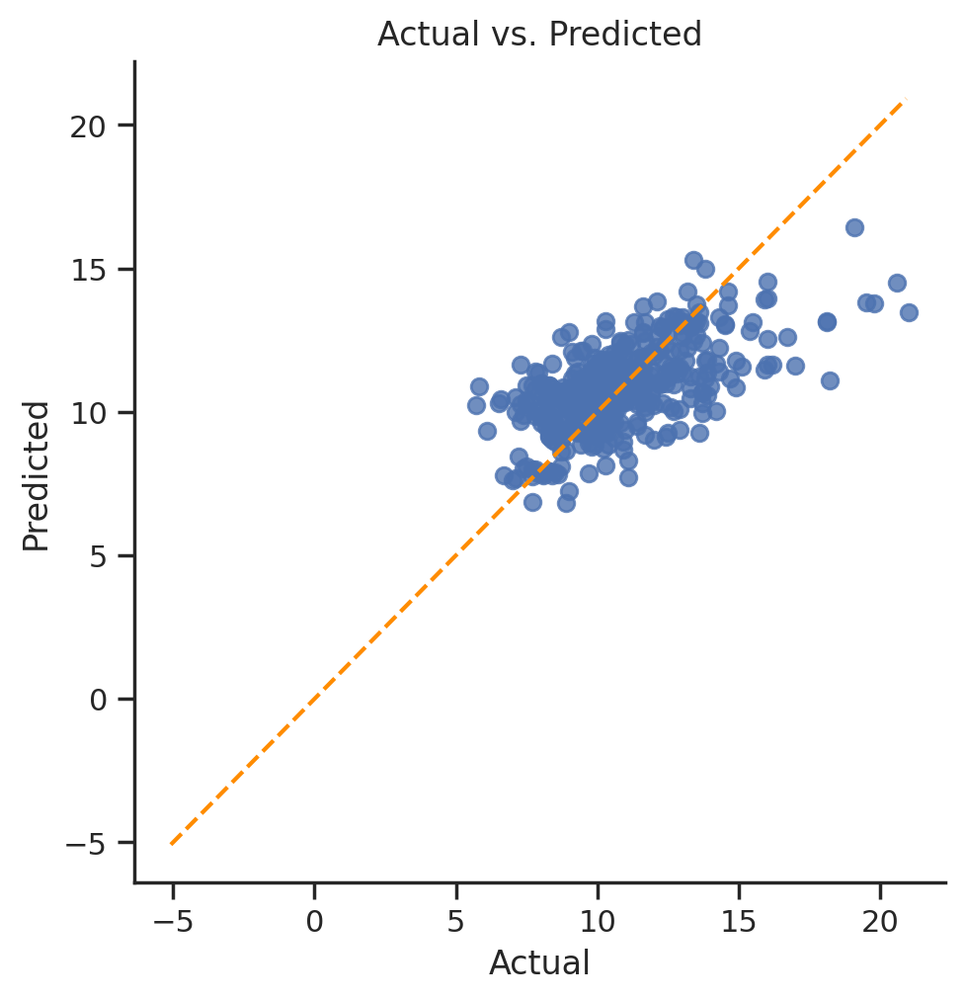

In [60]:
linear_assumption(ols_model, X, data_mortality.loc[:,y_cols])

Assumption 1: Linear Relationship between the Target and the Feature 

Checking with a scatter plot of actual vs. predicted. Predictions should follow the diagonal line.
my model predictions are: 
 0       10.600751
1       10.700650
4       11.547004
6       10.414140
9       10.010524
          ...    
2966     7.676404
2972     9.307797
2983    10.442898
2989    10.841233
3000    10.260339
Length: 390, dtype: float64
      Actual  Predicted  Residuals
0       11.9  10.600751   1.299249
1        8.6  10.700650  -2.100650
4       11.4  11.547004  -0.147004
6       11.0  10.414140   0.585860
9       10.2  10.010524   0.189476
...      ...        ...        ...
2966     7.1   7.676404  -0.576404
2972     9.4   9.307797   0.092203
2983    10.1  10.442898  -0.342898
2989     9.5  10.841233  -1.341233
3000    11.4  10.260339   1.139661

[390 rows x 3 columns]


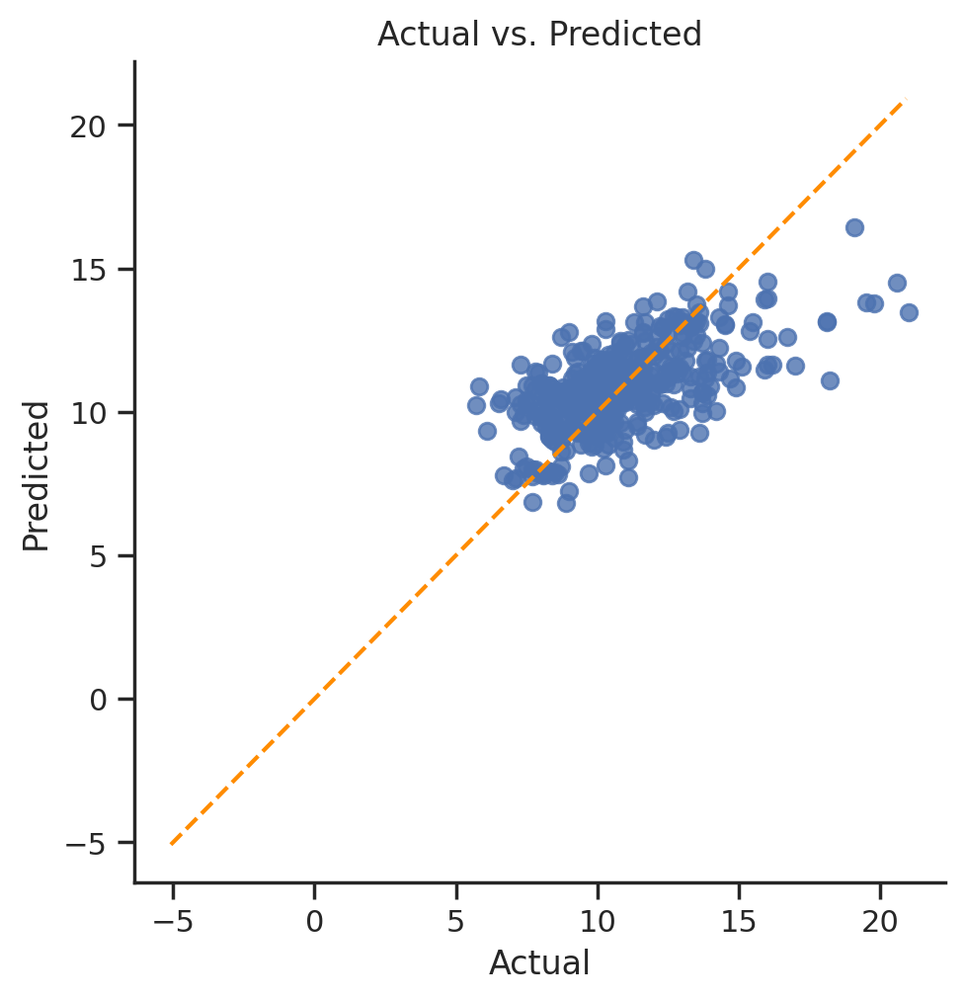

In [61]:
linear_assumption(model_fit_identity, X, data_mortality.loc[:,y_cols])

### For OLS and GLM:
#### They have similar results
#### GLM assumes linear relationship between transformed expected response in terms of identity link function and the response variable; therefore this linearity still applies.
#### Before applying any transformation, there seems to be linear relationship. 
####  However this relationship is not perfect where there is some bias towards higher values (around 16 - 20)

## Assumption 2: Error terms of the model are normally distributed check (For OLS NOT GLM)

In [62]:
def normal_errors_assumption(model, features, label, p_value_thresh=0.05):
    """
    Normality: Assumes that the error terms are normally distributed. If they are not,
    nonlinear transformations of variables may solve this.
               
    This assumption being violated primarily causes issues with t-test for confidence interval
    """
    print('Assumption 2: The error terms are normally distributed', '\n')
    
    # Calculating residuals for the Anderson-Darling test
    df_results = calculate_residuals(model, features, label)
    
    print('Using the Anderson-Darling test for normal distribution')

    # Performing the test on the residuals
    p_value = normal_ad(df_results['Residuals'])[1]
    print('p-value from the test - below 0.05 generally means non-normal:', p_value)
    
    # Reporting the normality of the residuals
    if p_value < p_value_thresh:
        print('Residuals are not normally distributed')
    else:
        print('Residuals are normally distributed')
    
    # Plotting the residuals distribution
    plt.subplots(figsize=(12, 6))
    plt.title('Distribution of Residuals')
    sns.histplot(df_results['Residuals'], kde=True, stat='density')
    plt.show()
    
    print()
    if p_value > p_value_thresh:
        print('Assumption satisfied')
    else:
        print('Assumption not satisfied')
        print()
        print('Confidence intervals will likely be affected')
        print('Should perform nonlinear transformations on variables')

Assumption 2: The error terms are normally distributed 

my model predictions are: 
 0       10.600751
1       10.700650
4       11.547004
6       10.414140
9       10.010524
          ...    
2966     7.676404
2972     9.307797
2983    10.442898
2989    10.841233
3000    10.260339
Length: 390, dtype: float64
Using the Anderson-Darling test for normal distribution
p-value from the test - below 0.05 generally means non-normal: 9.97596488170745e-06
Residuals are not normally distributed


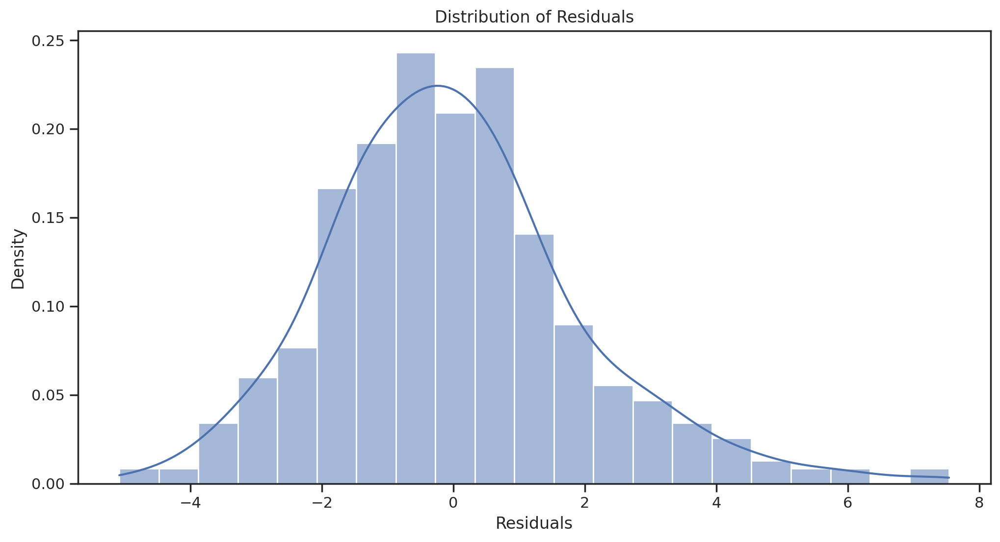


Assumption not satisfied

Confidence intervals will likely be affected
Should perform nonlinear transformations on variables


In [63]:
normal_errors_assumption(model_fit_identity, X, data_mortality.loc[:,y_cols])

Assumption 2: The error terms are normally distributed 

my model predictions are: 
 0       10.600751
1       10.700650
4       11.547004
6       10.414140
9       10.010524
          ...    
2966     7.676404
2972     9.307797
2983    10.442898
2989    10.841233
3000    10.260339
Length: 390, dtype: float64
Using the Anderson-Darling test for normal distribution
p-value from the test - below 0.05 generally means non-normal: 9.97596488170745e-06
Residuals are not normally distributed


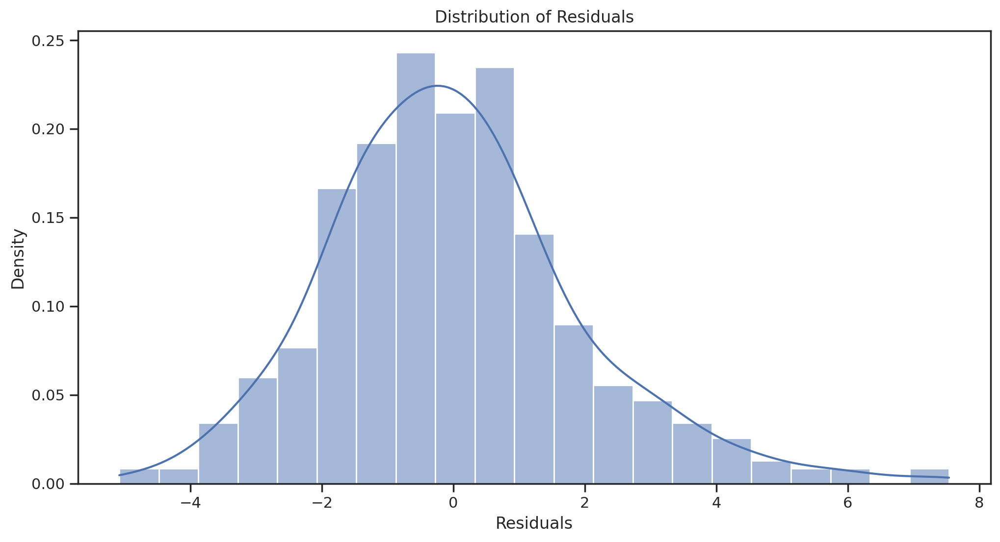


Assumption not satisfied

Confidence intervals will likely be affected
Should perform nonlinear transformations on variables


In [64]:
normal_errors_assumption(ols_model, X, data_mortality.loc[:,y_cols])

### Since our residual doesn't follow normal distribution; we decide to log transform `OVR` and use `log_OVR` as our outcome variable

In [65]:
X_cols_log = [
 'high_sch_grad_PE',
 "bachelors_PE",
 'unemployed_PE',
 'commute_walked_PE',
 'commute_worked_home_PE',
 'occup_construct_PE',
 'occup_transp_PE',
 'occup_agric_PE',
 'industry_construct_PE',
 'industry_manufacture_PE',
 'industry_transport_PE',
 'proverty_familiy_PE',
 'proverty_people_P',
 'male_PE',
 'female_PE',
 'age_under_5_PE',
 'age_5_9_PE',
 'median_age_E',
 'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']
y_cols = 'log_OVR'

In [66]:
#define response variable
y = data_mortality[y_cols]

#define predictor variables
X = data_mortality[X_cols_log]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
model_identity_log = sm.GLM(y, X, family=sm.families.Gaussian())
model_fit_identity_log = model_identity.fit()

#view model summary
print(model_fit_identity_log.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:                    OVR   No. Observations:                  390
Model:                            GLM   Df Residuals:                      365
Model Family:                Gaussian   Df Model:                           24
Link Function:               identity   Scale:                          3.9618
Method:                          IRLS   Log-Likelihood:                -808.92
Date:                Mon, 08 May 2023   Deviance:                       1446.0
Time:                        00:42:07   Pearson chi2:                 1.45e+03
No. Iterations:                     3   Pseudo R-squ. (CS):             0.4378
Covariance Type:            nonrobust                                         
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                     

In [67]:
#define response variable
y = data_mortality[y_cols]

#define predictor variables
X = data_mortality[X_cols_log]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
ols_model_log = sm.OLS(y, X).fit()

#view model summary
print(ols_model_log.summary())

                            OLS Regression Results                            
Dep. Variable:                log_OVR   R-squared:                       0.378
Model:                            OLS   Adj. R-squared:                  0.337
Method:                 Least Squares   F-statistic:                     9.247
Date:                Mon, 08 May 2023   Prob (F-statistic):           1.50e-25
Time:                        00:42:07   Log-Likelihood:                 135.40
No. Observations:                 390   AIC:                            -220.8
Df Residuals:                     365   BIC:                            -121.7
Df Model:                          24                                         
Covariance Type:            nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                     

Assumption 2: The error terms are normally distributed 

my model predictions are: 
 0       2.307483
1       2.359669
4       2.429294
6       2.325636
9       2.274215
          ...   
2966    2.053217
2972    2.230686
2983    2.320035
2989    2.359736
3000    2.330370
Length: 390, dtype: float64
Using the Anderson-Darling test for normal distribution
p-value from the test - below 0.05 generally means non-normal: 0.09074158767679698
Residuals are normally distributed


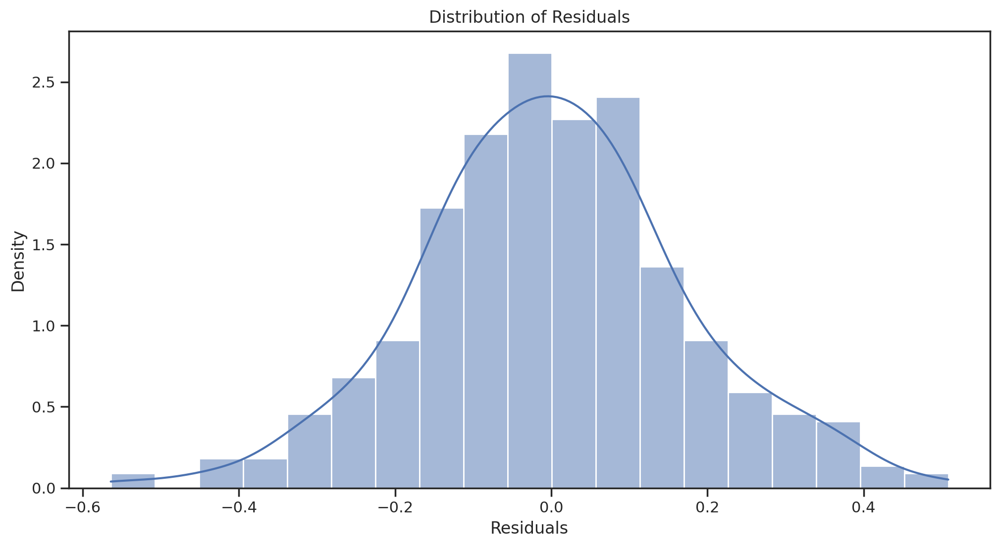


Assumption satisfied


In [68]:
normal_errors_assumption(ols_model_log, X, data_mortality.loc[:,y_cols])

Assumption 2: The error terms are normally distributed 

my model predictions are: 
 0       10.600751
1       10.700650
4       11.547004
6       10.414140
9       10.010524
          ...    
2966     7.676404
2972     9.307797
2983    10.442898
2989    10.841233
3000    10.260339
Length: 390, dtype: float64
Using the Anderson-Darling test for normal distribution
p-value from the test - below 0.05 generally means non-normal: 0.09151888070952229
Residuals are normally distributed


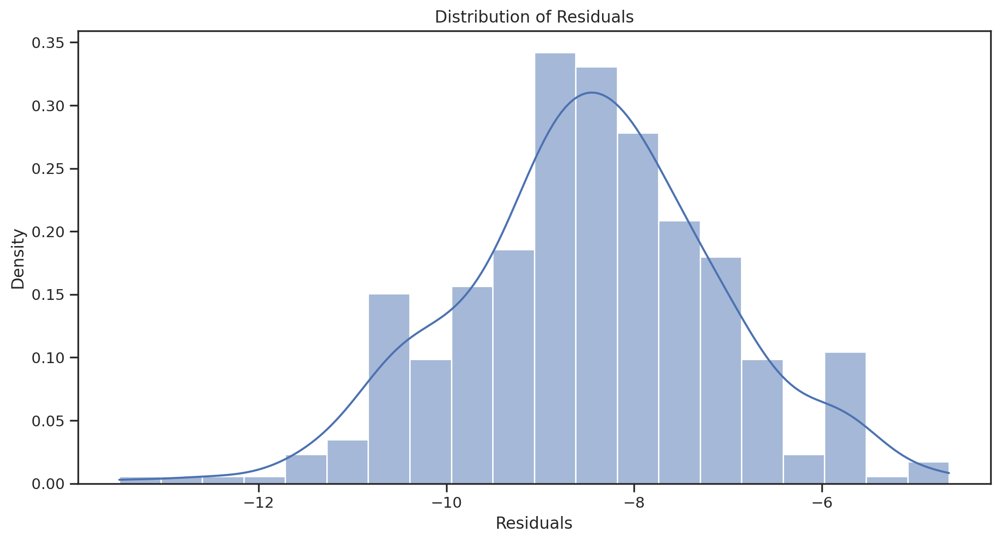


Assumption satisfied


In [69]:
normal_errors_assumption(model_fit_identity_log, X, data_mortality.loc[:,y_cols])

After applying log `OVR`, residual term follows normal distribution; which satisfy this OLS assumption.

## Assumption 3: Multicollinearity among predictors check (for feature selection):
### 1. Utilitize heatmap to find feature correlation
### 2. Use variance inflation factor (VIF), where also measure strength of correlation numerically

In [70]:
def multicollinearity_assumption(model, features, label, feature_names=None):
    """
    Multicollinearity: Assumes that predictors are not correlated with each other. If there is
                       correlation among the predictors, then either remove prepdictors with high
                       Variance Inflation Factor (VIF) values or perform dimensionality reduction
                           
                       This assumption being violated causes issues with interpretability of the 
                       coefficients and the standard errors of the coefficients.
    """
    from statsmodels.stats.outliers_influence import variance_inflation_factor
    print('Assumption 3: Little to no multicollinearity among predictors')
        
    # Plotting the heatmap
    plt.figure(figsize = (20,8))
    sns.heatmap(pd.DataFrame(features, columns=feature_names).corr(), annot=True)
    plt.title('Correlation of Variables')
    plt.show()
        
    print('Variance Inflation Factors (VIF)')
    print('> 10: An indication that multicollinearity may be present')
    print('> 100: Certain multicollinearity among the variables')
    print('-------------------------------------')
       
    # Gathering the VIF for each variable
    VIF = [variance_inflation_factor(features, i) for i in range(features.shape[1])]
    for idx, vif in enumerate(VIF):
        print('{0}: {1}'.format(feature_names[idx], vif))
        
    # Gathering and printing total cases of possible or definite multicollinearity
    possible_multicollinearity = sum([1 for vif in VIF if vif > 10])
    definite_multicollinearity = sum([1 for vif in VIF if vif > 100])
    print()
    print('{0} cases of possible multicollinearity'.format(possible_multicollinearity))
    print('{0} cases of definite multicollinearity'.format(definite_multicollinearity))
    print()

    if definite_multicollinearity == 0:
        if possible_multicollinearity == 0:
            print('Assumption satisfied')
        else:
            print('Assumption possibly satisfied')
            print()
            print('Coefficient interpretability may be problematic')
            print('Consider removing variables with a high Variance Inflation Factor (VIF)')

    else:
        print('Assumption not satisfied')
        print()
        print('Coefficient interpretability will be problematic')
        print('Consider removing variables with a high Variance Inflation Factor (VIF)')

In [71]:
data_mortality.columns

Index(['year', 'state', 'Question', 'OVR', 'high_sch_grad_PE', 'bachelor's_PE',
       'unemployed_PE', 'commute_walked_PE', 'commute_worked_home_PE',
       'occup_construct_PE', 'occup_transp_PE', 'occup_agric_PE',
       'industry_construct_PE', 'industry_manufacture_PE',
       'industry_transport_PE', 'proverty_familiy_PE', 'proverty_people_P',
       'male_PE', 'female_PE', 'age_under_5_PE', 'age_5_9_PE', 'median_age_E',
       'white_PE', 'black_PE', 'native_PE', 'asian_PE', 'hispanic_PE',
       'house_heat_coal_PE', 'house_heat_wood_PE', 'log_OVR', 'bachelors_PE'],
      dtype='object')

Assumption 3: Little to no multicollinearity among predictors


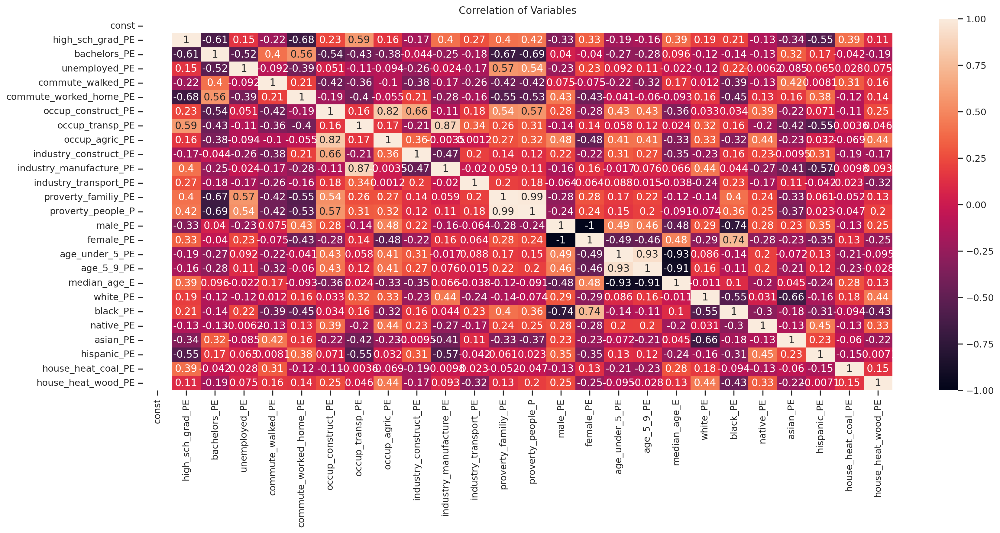

Variance Inflation Factors (VIF)
> 10: An indication that multicollinearity may be present
> 100: Certain multicollinearity among the variables
-------------------------------------
const: 0.0
high_sch_grad_PE: 8.9651790162229
bachelors_PE: 5.144508908388097
unemployed_PE: 4.650927951898455
commute_walked_PE: 3.9690762932195316
commute_worked_home_PE: 4.8246227216784625
occup_construct_PE: 24.478540415205316
occup_transp_PE: 25.50557612397443
occup_agric_PE: 11.982558542032978
industry_construct_PE: 10.420422637560844
industry_manufacture_PE: 20.252814217230835
industry_transport_PE: 3.4932793889572933
proverty_familiy_PE: 135.51794811832215
proverty_people_P: 122.8738722380139
male_PE: inf
female_PE: inf
age_under_5_PE: 17.741249009645223
age_5_9_PE: 14.651034517451226
median_age_E: 21.38499833381326
white_PE: 119.72845360220863
black_PE: 79.17761083234419
native_PE: 10.727774689736984
asian_PE: 78.92953619593247
hispanic_PE: 5.063488509826147
house_heat_coal_PE: 1.8979168831768376
ho

/opt/conda/lib/python3.9/site-packages/statsmodels/regression/linear_model.py:1752: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/opt/conda/lib/python3.9/site-packages/statsmodels/stats/outliers_influence.py:195: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)


In [72]:
multicollinearity_assumption(model_fit_identity_log, X, data_mortality.loc[:,y_cols], X.columns)

### There is 16 cases of possible multicollinearity and 5 cases of definite multicollinearity, this mean we will need to remove variables with high VIF
### The below variables are the filter variables

In [73]:
X_cols_updated = [
#  'high_sch_grad_PE',
#  "bachelor's_PE",
#  'unemployed_PE',
 'commute_walked_PE',
#  'commute_worked_home_PE',
#  'occup_construct_PE',
#  'occup_transp_PE',
#  'occup_agric_PE',
#  'industry_construct_PE',
#  'industry_manufacture_PE',
 'industry_transport_PE',
#  'proverty_familiy_PE',
#  'proverty_people_P',
#  'male_PE',
#  'female_PE',
#  'age_under_5_PE',
 'age_5_9_PE',
#  'median_age_E',
#  'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']
y_cols = 'log_OVR'

In [74]:
#define response variable
y = data_mortality[y_cols]

#define predictor variables
X = data_mortality[X_cols_updated]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
ols_model_updated = sm.OLS(y, X).fit()

#view model summary
print(ols_model_updated.summary())

                            OLS Regression Results                            
Dep. Variable:                log_OVR   R-squared:                       0.322
Model:                            OLS   Adj. R-squared:                  0.306
Method:                 Least Squares   F-statistic:                     20.09
Date:                Mon, 08 May 2023   Prob (F-statistic):           1.30e-27
Time:                        00:42:12   Log-Likelihood:                 118.66
No. Observations:                 390   AIC:                            -217.3
Df Residuals:                     380   BIC:                            -177.7
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.92

In [75]:
#define response variable
y = data_mortality[y_cols]

#define predictor variables
X = data_mortality[X_cols_updated]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
model_fit_identity_log_updated = sm.GLM(y, X, family=sm.families.Gaussian())
model_fit_identity_log_updated = model_fit_identity_log_updated.fit()

#view model summary
print(model_fit_identity_log_updated.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:                log_OVR   No. Observations:                  390
Model:                            GLM   Df Residuals:                      380
Model Family:                Gaussian   Df Model:                            9
Link Function:               identity   Scale:                        0.032698
Method:                          IRLS   Log-Likelihood:                 118.66
Date:                Mon, 08 May 2023   Deviance:                       12.425
Time:                        00:42:12   Pearson chi2:                     12.4
No. Iterations:                     3   Pseudo R-squ. (CS):             0.3711
Covariance Type:            nonrobust                                         
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.92

Assumption 3: Little to no multicollinearity among predictors


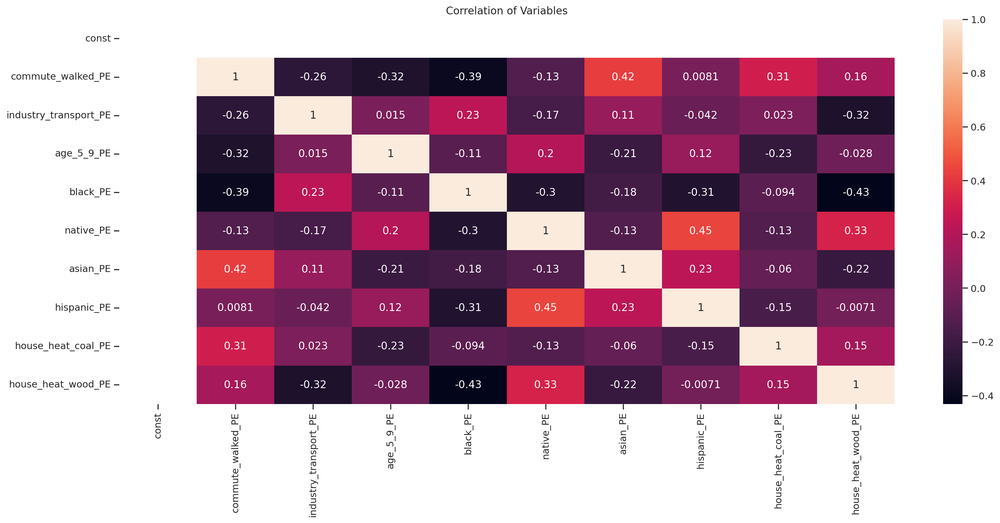

Variance Inflation Factors (VIF)
> 10: An indication that multicollinearity may be present
> 100: Certain multicollinearity among the variables
-------------------------------------
const: 298.56145215532763
commute_walked_PE: 1.978827187233575
industry_transport_PE: 1.2706190992380433
age_5_9_PE: 1.2761097618319401
black_PE: 1.797589951704354
native_PE: 1.5937859493739555
asian_PE: 1.6429225791093922
hispanic_PE: 1.5104508035061244
house_heat_coal_PE: 1.254562063420848
house_heat_wood_PE: 1.628923437329916

1 cases of possible multicollinearity
1 cases of definite multicollinearity

Assumption not satisfied

Coefficient interpretability will be problematic
Consider removing variables with a high Variance Inflation Factor (VIF)


In [76]:
multicollinearity_assumption(model_fit_identity_log_updated, X, data_mortality.loc[:,y_cols], X.columns)

### constant is not a predictor and has irrational VIF values. Therefore, this can be ignored. Now there is less chance of collinearity between variables.

## Autocorrelation of Error Terms check using Durbin-Watson test

### 1. Assume no autocorrelation of error terms; autocorerlation exist because of time-series data, where we have information from the past that we are not capturing since we have years and states as our individual ID.
### 2. Errors need to be independent but NOT normally distributed (FOR GLM ONLY)

In [77]:
def autocorrelation_assumption(model, features, label):
    """
    Autocorrelation: Assumes that there is no autocorrelation in the residuals. If there is
                     autocorrelation, then there is a pattern that is not explained due to
                     the current value being dependent on the previous value.
                     This may be resolved by adding a lag variable of either the dependent
                     variable or some of the predictors.
    """
    from statsmodels.stats.stattools import durbin_watson
    print('Assumption 4: No Autocorrelation', '\n')
    
    # Calculating residuals for the Durbin Watson-tests
    df_results = calculate_residuals(model, features, label)

    print('\nPerforming Durbin-Watson Test')
    print('Values of 1.5 < d < 2.5 generally show that there is no autocorrelation in the data')
    print('0 to 2< is positive autocorrelation')
    print('>2 to 4 is negative autocorrelation')
    print('-------------------------------------')
    durbinWatson = durbin_watson(df_results['Residuals'])
    print('Durbin-Watson:', durbinWatson)
    if durbinWatson < 1.5:
        print('Signs of positive autocorrelation', '\n')
        print('Assumption not satisfied')
    elif durbinWatson > 2.5:
        print('Signs of negative autocorrelation', '\n')
        print('Assumption not satisfied')
    else:
        print('Little to no autocorrelation', '\n')
        print('Assumption satisfied')

In [78]:
autocorrelation_assumption(ols_model_updated, X, data_mortality.loc[:,y_cols])

Assumption 4: No Autocorrelation 

my model predictions are: 
 0       2.341713
1       2.341244
4       2.429607
6       2.280845
9       2.312936
          ...   
2966    2.152419
2972    2.382676
2983    2.311026
2989    2.433536
3000    2.303336
Length: 390, dtype: float64

Performing Durbin-Watson Test
Values of 1.5 < d < 2.5 generally show that there is no autocorrelation in the data
0 to 2< is positive autocorrelation
>2 to 4 is negative autocorrelation
-------------------------------------
Durbin-Watson: 1.9769991166382594
Little to no autocorrelation 

Assumption satisfied


In [79]:
autocorrelation_assumption(model_fit_identity_log_updated, X, data_mortality.loc[:,y_cols])

Assumption 4: No Autocorrelation 

my model predictions are: 
 0       2.341713
1       2.341244
4       2.429607
6       2.280845
9       2.312936
          ...   
2966    2.152419
2972    2.382676
2983    2.311026
2989    2.433536
3000    2.303336
Length: 390, dtype: float64

Performing Durbin-Watson Test
Values of 1.5 < d < 2.5 generally show that there is no autocorrelation in the data
0 to 2< is positive autocorrelation
>2 to 4 is negative autocorrelation
-------------------------------------
Durbin-Watson: 1.9769991166382594
Little to no autocorrelation 

Assumption satisfied


## Homoscedasticity assumption check: even variance across the error terms

### 1. We do not want our model to give too much weight on a subset of data where the error variance is the largest 

In [80]:
def homoscedasticity_assumption(model, features, label):
    """
    Homoscedasticity: Assumes that the errors exhibit constant variance
    """
    print('Assumption 5: Homoscedasticity of Error Terms', '\n')
    
    print('Residuals should have relative constant variance')
        
    # Calculating residuals for the plot
    df_results = calculate_residuals(model, features, label)

    # Plotting the residuals
    plt.subplots(figsize=(12, 6))
    ax = plt.subplot(111)  # To remove spines
    plt.scatter(x=df_results.index, y=df_results.Residuals, alpha=0.5)
    plt.plot(np.repeat(0, df_results.index.max()), color='darkorange', linestyle='--')
    ax.spines['right'].set_visible(False)  # Removing the right spine
    ax.spines['top'].set_visible(False)  # Removing the top spine
    plt.title('Residuals')
    plt.show()  

Assumption 5: Homoscedasticity of Error Terms 

Residuals should have relative constant variance
my model predictions are: 
 0       2.341713
1       2.341244
4       2.429607
6       2.280845
9       2.312936
          ...   
2966    2.152419
2972    2.382676
2983    2.311026
2989    2.433536
3000    2.303336
Length: 390, dtype: float64


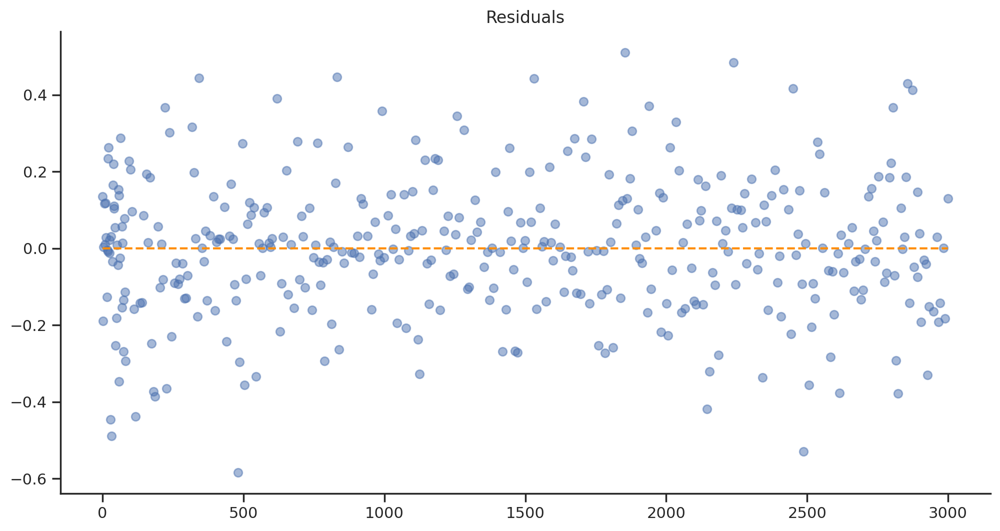

In [81]:
homoscedasticity_assumption(ols_model_updated, X, data_mortality.loc[:,y_cols])

Assumption 5: Homoscedasticity of Error Terms 

Residuals should have relative constant variance
my model predictions are: 
 0       2.341713
1       2.341244
4       2.429607
6       2.280845
9       2.312936
          ...   
2966    2.152419
2972    2.382676
2983    2.311026
2989    2.433536
3000    2.303336
Length: 390, dtype: float64


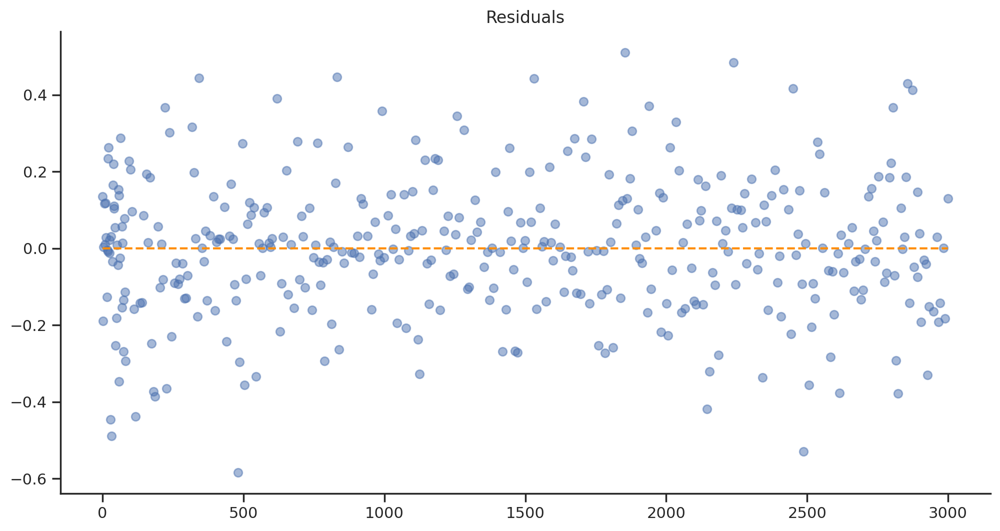

In [82]:
homoscedasticity_assumption(model_fit_identity_log_updated, X, data_mortality.loc[:,y_cols])

### Residual Terms seems spread out and not concentrated in one area. We can safely assume this assumptions checks.

### Although our GLM is linear regression but given the model structure, the assumption of homogeneity of variance does NOT need to be satisfied. This only applies to OLS. 

## Attempted Feature Engineering 

### 1. Apply Log transformation for skewed variables 
### 2. Boxcox transformation of race variables (the need to put everyone on the same scale) because our EDA shows different race are on different scales. 
### 3. Square root to reduce right skewness if we think Y is proportional to X^2 

In [83]:
# Select predictor variables to plot against log_OVR
predictor_vars = [
 'high_sch_grad_PE',
 "bachelor's_PE",
 'unemployed_PE',
 'commute_walked_PE',
 'commute_worked_home_PE',
 'occup_construct_PE',
 'occup_transp_PE',
 'occup_agric_PE',
 'industry_construct_PE',
 'industry_manufacture_PE',
 'industry_transport_PE',
 'proverty_familiy_PE',
 'proverty_people_P',
 'male_PE',
 'female_PE',
 'age_under_5_PE',
 'age_5_9_PE',
 'median_age_E',
 'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']


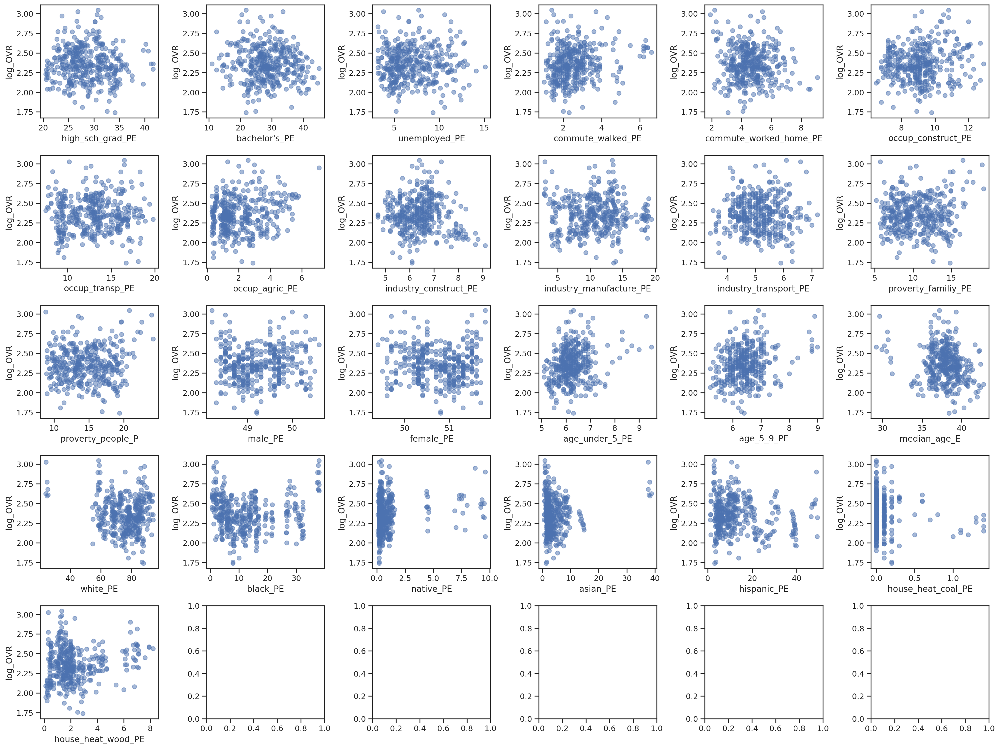

In [84]:
# Create a custom grid of scatter plots for all predictor variables
fig, axs = plt.subplots(nrows=5, ncols=6, figsize=(20, 15))
for i in range(len(predictor_vars)):
    row = i // 6
    col = i % 6
    axs[row, col].scatter(data_mortality[predictor_vars[i]], data_mortality['log_OVR'], alpha=0.5)
    axs[row, col].set_xlabel(predictor_vars[i])
    axs[row, col].set_ylabel('log_OVR')
plt.tight_layout()
plt.show()

In [85]:
X_cols_updated = [
#  'high_sch_grad_PE',
#  "bachelor's_PE",
#  'unemployed_PE',
 'commute_walked_PE',
#  'commute_worked_home_PE',
#  'occup_construct_PE',
#  'occup_transp_PE',
#  'occup_agric_PE',
#  'industry_construct_PE',
#  'industry_manufacture_PE',
 'industry_transport_PE',
#  'proverty_familiy_PE',
#  'proverty_people_P',
#  'male_PE',
#  'female_PE',
#  'age_under_5_PE',
 'age_5_9_PE',
#  'median_age_E',
#  'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']

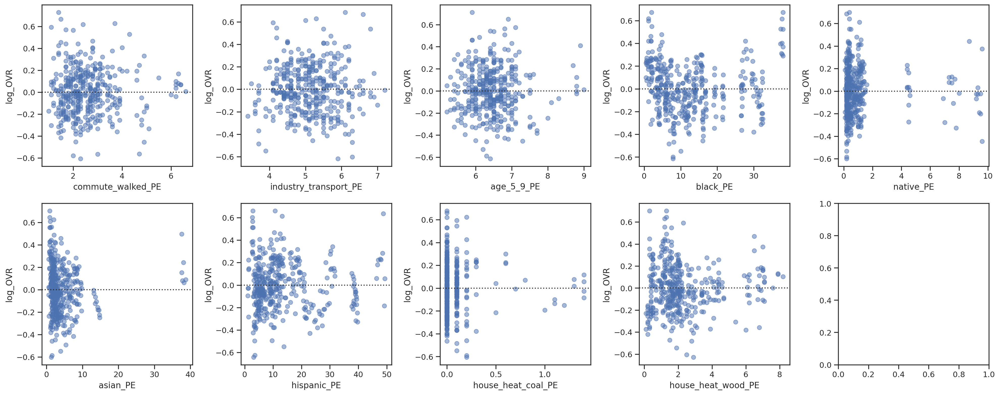

In [86]:
# Create a custom grid of scatter plots for all predictor variables
fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(20, 8))

for i in range(len(X_cols_updated)):
    row = i // 5
    col = i % 5
    sns.residplot(x=data_mortality[X_cols_updated[i]], y=data_mortality['log_OVR'], 
                  scatter_kws={'alpha': 0.5}, ax=axs[row, col])
    axs[row, col].set_xlabel(X_cols_updated[i])
    axs[row, col].set_ylabel('log_OVR')

plt.tight_layout()
plt.show()

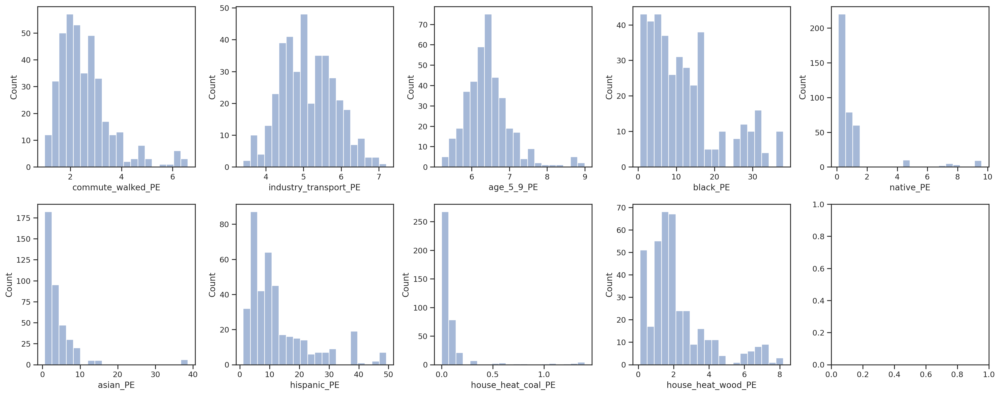

In [87]:
# Create a grid of histograms for all predictor variables
fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(20, 8))
for i in range(len(X_cols_updated)):
    row = i // 5
    col = i % 5
    sns.histplot(data_mortality[X_cols_updated[i]], bins=20, alpha=0.5, ax=axs[row, col])
    axs[row, col].set_xlabel(X_cols_updated[i])
    axs[row, col].set_ylabel('Count')
plt.tight_layout()
plt.show()

In [88]:
X_cols_updated = [
#  'high_sch_grad_PE',
#  "bachelor's_PE",
#  'unemployed_PE',
 'commute_walked_PE',
#  'commute_worked_home_PE',
#  'occup_construct_PE',
#  'occup_transp_PE',
#  'occup_agric_PE',
#  'industry_construct_PE',
#  'industry_manufacture_PE',
 'industry_transport_PE',
#  'proverty_familiy_PE',
#  'proverty_people_P',
#  'male_PE',
#  'female_PE',
#  'age_under_5_PE',
 'age_5_9_PE',
#  'median_age_E',
#  'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']

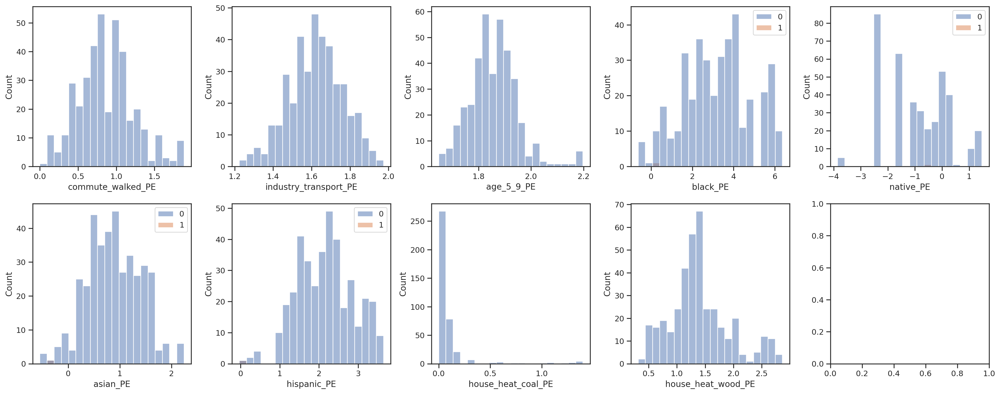

In [89]:
# Create a grid of histograms for all predictor variables
fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(20, 8))
for i in range(len(X_cols_updated)):
    row = i // 5
    col = i % 5
    if i <= 2:
        sns.histplot(np.log(data_mortality[X_cols_updated[i]]), bins=20, alpha=0.5, ax=axs[row, col])
    elif i <= 6 and i >=3:
        sns.histplot(boxcox(data_mortality[X_cols_updated[i]]), bins=20, alpha=0.5, ax=axs[row, col])
    elif i == 7:
        sns.histplot((data_mortality[X_cols_updated[i]]), bins=20, alpha=0.5, ax=axs[row, col])
    else:
        sns.histplot(np.sqrt(data_mortality[X_cols_updated[i]]), bins=20, alpha=0.5, ax=axs[row, col])
    axs[row, col].set_xlabel(X_cols_updated[i])
    axs[row, col].set_ylabel('Count')
plt.tight_layout()
plt.show()

### Variable transformation 

In [90]:
for i in range(len(X_cols_updated)):
    if i <= 2:
        data_mortality[f'log_{X_cols_updated[i]}'] = np.log(data_mortality[X_cols_updated[i]])
    elif i <= 6 and i >=3:
         data_mortality[f'boxcox_{X_cols_updated[i]}'] = boxcox(data_mortality[X_cols_updated[i]])[0]
    elif i == 7:
        data_mortality[X_cols_updated[i]] = data_mortality[X_cols_updated[i]] 
    else:
        data_mortality[f'sqrt_{X_cols_updated[i]}'] = np.sqrt(data_mortality[X_cols_updated[i]])

In [91]:
data_mortality.columns

Index(['year', 'state', 'Question', 'OVR', 'high_sch_grad_PE', 'bachelor's_PE',
       'unemployed_PE', 'commute_walked_PE', 'commute_worked_home_PE',
       'occup_construct_PE', 'occup_transp_PE', 'occup_agric_PE',
       'industry_construct_PE', 'industry_manufacture_PE',
       'industry_transport_PE', 'proverty_familiy_PE', 'proverty_people_P',
       'male_PE', 'female_PE', 'age_under_5_PE', 'age_5_9_PE', 'median_age_E',
       'white_PE', 'black_PE', 'native_PE', 'asian_PE', 'hispanic_PE',
       'house_heat_coal_PE', 'house_heat_wood_PE', 'log_OVR', 'bachelors_PE',
       'log_commute_walked_PE', 'log_industry_transport_PE', 'log_age_5_9_PE',
       'boxcox_black_PE', 'boxcox_native_PE', 'boxcox_asian_PE',
       'boxcox_hispanic_PE', 'sqrt_house_heat_wood_PE'],
      dtype='object')

# Frequentist Modeling

### Train Test Split

In [92]:
train, test = train_test_split(data_mortality, test_size = 0.30, random_state=100)

## Linear Regression

### Transformed variable columns

In [93]:
new_X_cols = [
'log_commute_walked_PE', 'log_industry_transport_PE', 'log_age_5_9_PE',
       'boxcox_black_PE', 'boxcox_native_PE', 'boxcox_asian_PE','house_heat_coal_PE',
       'boxcox_hispanic_PE']

y_cols = ['log_OVR']

In [94]:
#define response variable
y = data_mortality[y_cols]

#define predictor variables
X = data_mortality[new_X_cols]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
model = sm.OLS(y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                log_OVR   R-squared:                       0.230
Model:                            OLS   Adj. R-squared:                  0.213
Method:                 Least Squares   F-statistic:                     14.19
Date:                Mon, 08 May 2023   Prob (F-statistic):           3.97e-18
Time:                        00:42:26   Log-Likelihood:                 93.648
No. Observations:                 390   AIC:                            -169.3
Df Residuals:                     381   BIC:                            -133.6
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

In [95]:
#define response variable
y = data_mortality[y_cols]

#define predictor variables
X = data_mortality[new_X_cols]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
model_glm = sm.GLM(y, X, family=sm.families.Gaussian()).fit()

#view model summary
print(model_glm.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:                log_OVR   No. Observations:                  390
Model:                            GLM   Df Residuals:                      381
Model Family:                Gaussian   Df Model:                            8
Link Function:               identity   Scale:                        0.037076
Method:                          IRLS   Log-Likelihood:                 93.648
Date:                Mon, 08 May 2023   Deviance:                       14.126
Time:                        00:42:26   Pearson chi2:                     14.1
No. Iterations:                     3   Pseudo R-squ. (CS):             0.2528
Covariance Type:            nonrobust                                         
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

In [96]:
newest_X_cols = [
'const', 'log_commute_walked_PE', 'log_industry_transport_PE', 'log_age_5_9_PE',
       'boxcox_black_PE', 'boxcox_native_PE', 'boxcox_asian_PE','house_heat_coal_PE',
       'boxcox_hispanic_PE']

y_cols = ['log_OVR']

## OLS Transformed Variable Predictions

In [97]:
train['linear_pred'] = model.predict(sm.add_constant(train).loc[:,newest_X_cols])
test['linear_pred'] = model.predict(sm.add_constant(test).loc[:,newest_X_cols])

In [98]:
train_rmse = np.mean((train["linear_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["linear_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for linear model:", train_rmse)
print("Test set error for linear model:    ", test_rmse)

Training set error for linear model: 0.19956275558576336
Test set error for linear model:     0.1667642563642375


## GLM Normal + Identity Transformed Variable Predictions

In [99]:
train['linear_pred'] = model_glm.predict(sm.add_constant(train).loc[:,newest_X_cols])
test['linear_pred'] = model_glm.predict(sm.add_constant(test).loc[:,newest_X_cols])

In [100]:
train_rmse = np.mean((train["linear_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["linear_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for linear model:", train_rmse)
print("Test set error for linear model:    ", test_rmse)

Training set error for linear model: 0.19956275558576336
Test set error for linear model:     0.1667642563642375


### Untransformed variable columns

In [101]:
X_cols_updated = [
#  'high_sch_grad_PE',
#  "bachelor's_PE",
#  'unemployed_PE',
 'commute_walked_PE',
#  'commute_worked_home_PE',
#  'occup_construct_PE',
#  'occup_transp_PE',
#  'occup_agric_PE',
#  'industry_construct_PE',
#  'industry_manufacture_PE',
 'industry_transport_PE',
#  'proverty_familiy_PE',
#  'proverty_people_P',
#  'male_PE',
#  'female_PE',
#  'age_under_5_PE',
 'age_5_9_PE',
#  'median_age_E',
#  'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']

y_cols = ['log_OVR']

In [102]:
#define response variable
y = data_mortality[y_cols]

#define predictor variables
X = data_mortality[X_cols_updated]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
model = sm.OLS(y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                log_OVR   R-squared:                       0.322
Model:                            OLS   Adj. R-squared:                  0.306
Method:                 Least Squares   F-statistic:                     20.09
Date:                Mon, 08 May 2023   Prob (F-statistic):           1.30e-27
Time:                        00:42:26   Log-Likelihood:                 118.66
No. Observations:                 390   AIC:                            -217.3
Df Residuals:                     380   BIC:                            -177.7
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.92

In [103]:
#define response variable
y = data_mortality[y_cols]

#define predictor variables
X = data_mortality[X_cols_updated]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
model_glm = sm.GLM(y, X, family=sm.families.Gaussian()).fit()

#view model summary
print(model_glm.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:                log_OVR   No. Observations:                  390
Model:                            GLM   Df Residuals:                      380
Model Family:                Gaussian   Df Model:                            9
Link Function:               identity   Scale:                        0.032698
Method:                          IRLS   Log-Likelihood:                 118.66
Date:                Mon, 08 May 2023   Deviance:                       12.425
Time:                        00:42:26   Pearson chi2:                     12.4
No. Iterations:                     3   Pseudo R-squ. (CS):             0.3711
Covariance Type:            nonrobust                                         
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.92

In [104]:
X_cols_updated2 = [
'const',
#  'high_sch_grad_PE',
#  "bachelor's_PE",
#  'unemployed_PE',
 'commute_walked_PE',
#  'commute_worked_home_PE',
#  'occup_construct_PE',
#  'occup_transp_PE',
#  'occup_agric_PE',
#  'industry_construct_PE',
#  'industry_manufacture_PE',
 'industry_transport_PE',
#  'proverty_familiy_PE',
#  'proverty_people_P',
#  'male_PE',
#  'female_PE',
#  'age_under_5_PE',
 'age_5_9_PE',
#  'median_age_E',
#  'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']

y_cols = ['log_OVR']

## OLS Untransformed Variable Predictions

In [105]:
train['linear_pred'] = model.predict(sm.add_constant(train).loc[:,X_cols_updated2])
test['linear_pred'] = model.predict(sm.add_constant(test).loc[:,X_cols_updated2])

In [106]:
train_rmse = np.mean((train["linear_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["linear_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for linear model:", train_rmse)
print("Test set error for linear model:    ", test_rmse)

Training set error for linear model: 0.18636193014088825
Test set error for linear model:     0.15862360407072915


## GLM Untransformed Variable Predictions

In [107]:
train['linear_pred'] = model_glm.predict(sm.add_constant(train).loc[:,X_cols_updated2])
test['linear_pred'] = model_glm.predict(sm.add_constant(test).loc[:,X_cols_updated2])

In [108]:
train_rmse = np.mean((train["linear_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["linear_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for linear model:", train_rmse)
print("Test set error for linear model:    ", test_rmse)

Training set error for linear model: 0.18636193014088825
Test set error for linear model:     0.15862360407072915


## Untransformed prediction is better than Transformed predictions 

### Here are some limitations: 
1. Made some initial thought of making outlier not look like outliers 
2. transform for statstical reasons (just to look normal), which may not be approriate
3. skewness of a variable is not necessairly a good reason to conduct transformation when values are not widely spreadout

## Second Feature Engineering Attempt: Merge PM2.5 and fips dataset

### Merge 2010-2014 data with data_mortality

In [109]:
fips = pd.read_csv('fips.csv')
fips

,stname,st,stusps
0,Alabama,1,AL
1,Alaska,2,AK
2,Arizona,4,AZ
3,Arkansas,5,AR
4,California,6,CA
5,Colorado,8,CO
6,Connecticut,9,CT
7,Delaware,10,DE
8,District of Columbia,11,DC
9,Florida,12,FL


In [110]:
fips.columns

Index(['stname', ' st', ' stusps'], dtype='object')

In [111]:
pm25 = pd.read_csv('pm25_by_year_state.csv')

pm25_merged = pd.merge(fips, pm25, left_on=' st', right_on='statefips')

In [112]:
pm25_merged2 = pm25_merged.drop([' st', 'statefips', ' stusps'], axis=1)
pm25_merged2

,stname,year,ds_pm_pred,ds_pm_stdd
0,Alabama,2011,10.696324,3.159462
1,Alabama,2012,10.396601,4.228621
2,Alabama,2013,10.039805,4.201070
3,Alabama,2014,11.007064,5.885860
4,Arizona,2011,7.929366,3.072249
...,...,...,...,...
191,Wisconsin,2014,9.442967,4.801436
192,Wyoming,2011,5.900019,2.712466
193,Wyoming,2012,6.258089,2.730487
194,Wyoming,2013,5.198567,2.414342


In [113]:
data_mortality_2010_2014 = pd.merge(pm25_merged2, data_mortality, left_on=['stname', 'year'], right_on=['state', 'year']).drop(['stname'], axis=1)
data_mortality_2010_2014

,year,ds_pm_pred,ds_pm_stdd,state,Question,OVR,high_sch_grad_PE,bachelor's_PE,unemployed_PE,commute_walked_PE,...,log_OVR,bachelors_PE,log_commute_walked_PE,log_industry_transport_PE,log_age_5_9_PE,boxcox_black_PE,boxcox_native_PE,boxcox_asian_PE,boxcox_hispanic_PE,sqrt_house_heat_wood_PE
0,2011,10.696324,3.159462,Alabama,Asthma mortality rate,7.4,30.9,22.3,11.6,1.1,...,2.001480,22.3,0.095310,1.609438,1.840550,5.424381,-0.802919,0.093992,1.329405,1.048809
1,2012,10.396601,4.228621,Alabama,Asthma mortality rate,10.9,31.3,23.3,10.0,1.2,...,2.388763,23.3,0.182322,1.722767,1.871802,5.405316,-0.802919,0.177538,1.304614,1.095445
2,2013,10.039805,4.201070,Alabama,Asthma mortality rate,8.4,31.0,23.5,9.6,1.0,...,2.128232,23.5,0.000000,1.589235,1.840550,5.414861,-0.802919,0.177538,1.329405,1.048809
3,2014,11.007064,5.885860,Alabama,Asthma mortality rate,10.7,31.6,23.5,8.6,1.1,...,2.370244,23.5,0.095310,1.568616,1.840550,5.414861,-0.802919,0.177538,1.353547,1.000000
4,2011,7.929366,3.072249,Arizona,Asthma mortality rate,13.3,24.6,26.6,11.1,2.2,...,2.587764,26.6,0.788457,1.609438,1.945910,1.735023,1.119353,0.861793,3.211506,1.449138
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148,2013,8.895083,3.519392,West Virginia,Asthma mortality rate,13.6,40.2,18.9,8.5,2.8,...,2.610070,18.9,1.029619,1.704748,1.704748,1.462983,-3.852110,-0.551030,0.334520,2.588436
149,2011,9.807034,2.934875,Wisconsin,Asthma mortality rate,10.1,33.1,26.5,8.2,3.4,...,2.312535,26.5,1.223775,1.526056,1.856298,2.389712,-0.233783,0.739073,1.737308,2.167948
150,2012,9.455731,3.627430,Wisconsin,Asthma mortality rate,11.6,32.4,27.1,7.3,3.3,...,2.451005,27.1,1.193922,1.435085,1.871802,2.416616,-0.107694,0.772211,1.768108,2.144761
151,2013,8.935373,3.527595,Wisconsin,Asthma mortality rate,11.1,32.0,27.7,6.5,3.5,...,2.406945,27.7,1.252763,1.435085,1.840550,2.389712,-0.107694,0.803609,1.783124,2.144761


In [114]:
data_mortality_2010_2014['log_ds_pm_pred'] = np.log(data_mortality_2010_2014['ds_pm_pred'])
data_mortality_2010_2014['log_ds_pm_pred'] 

0      2.369900
1      2.341479
2      2.306558
3      2.398537
4      2.070573
         ...   
148    2.185499
149    2.283100
150    2.246621
151    2.190018
152    2.245270
Name: log_ds_pm_pred, Length: 153, dtype: float64

In [115]:
data_mortality_2010_2014['log_ds_pm_stdd'] = np.log(data_mortality_2010_2014['ds_pm_stdd'])
data_mortality_2010_2014['log_ds_pm_stdd']

0      1.150402
1      1.441876
2      1.435339
3      1.772553
4      1.122410
         ...   
148    1.258288
149    1.076665
150    1.288524
151    1.260616
152    1.568915
Name: log_ds_pm_stdd, Length: 153, dtype: float64

## After merging PM dataset, there only exist 2010 - 2014 dataset and reduces our dataframe from 390 to 153.
### This may serve as a limitation for small sample size in modeling. 

In [116]:
train_2010_2014, test_2010_2014 = train_test_split(data_mortality_2010_2014, test_size = 0.30, random_state=100)

In [117]:
X_cols_updated3 = [
# 'const',
'log_ds_pm_pred',
'log_ds_pm_stdd',
# 'ds_pm_pred',
# 'ds_pm_stdd',
#  'high_sch_grad_PE',
#  "bachelor's_PE",
#  'unemployed_PE',
 'commute_walked_PE',
#  'commute_worked_home_PE',
#  'occup_construct_PE',
#  'occup_transp_PE',
#  'occup_agric_PE',
#  'industry_construct_PE',
#  'industry_manufacture_PE',
#  'industry_transport_PE',
#  'proverty_familiy_PE',
#  'proverty_people_P',
#  'male_PE',
#  'female_PE',
#  'age_under_5_PE',
 'age_5_9_PE',
#  'median_age_E',
#  'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
#  'house_heat_coal_PE',
 'house_heat_wood_PE']

y_cols = ['log_OVR']

In [118]:
#define response variable
y = data_mortality_2010_2014[y_cols]

#define predictor variables
X = data_mortality_2010_2014[X_cols_updated3]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
model = sm.OLS(y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                log_OVR   R-squared:                       0.402
Model:                            OLS   Adj. R-squared:                  0.364
Method:                 Least Squares   F-statistic:                     10.67
Date:                Mon, 08 May 2023   Prob (F-statistic):           1.47e-12
Time:                        00:42:27   Log-Likelihood:                 50.405
No. Observations:                 153   AIC:                            -80.81
Df Residuals:                     143   BIC:                            -50.50
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.8632      0

In [119]:
#define response variable
y = data_mortality_2010_2014[y_cols]

#define predictor variables
X = data_mortality_2010_2014[X_cols_updated3]

#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
model_glm = sm.GLM(y, X, family=sm.families.Gaussian()).fit()

#view model summary
print(model_glm.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:                log_OVR   No. Observations:                  153
Model:                            GLM   Df Residuals:                      143
Model Family:                Gaussian   Df Model:                            9
Link Function:               identity   Scale:                        0.032414
Method:                          IRLS   Log-Likelihood:                 50.405
Date:                Mon, 08 May 2023   Deviance:                       4.6352
Time:                        00:42:27   Pearson chi2:                     4.64
No. Iterations:                     3   Pseudo R-squ. (CS):             0.4673
Covariance Type:            nonrobust                                         
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.8632      0

In [120]:
X_cols_updated3 = [
'const',
'log_ds_pm_pred',
'log_ds_pm_stdd',
# 'ds_pm_pred',
# 'ds_pm_stdd',
#  'high_sch_grad_PE',
#  "bachelor's_PE",
#  'unemployed_PE',
 'commute_walked_PE',
#  'commute_worked_home_PE',
#  'occup_construct_PE',
#  'occup_transp_PE',
#  'occup_agric_PE',
#  'industry_construct_PE',
#  'industry_manufacture_PE',
#  'industry_transport_PE',
#  'proverty_familiy_PE',
#  'proverty_people_P',
#  'male_PE',
#  'female_PE',
#  'age_under_5_PE',
 'age_5_9_PE',
#  'median_age_E',
#  'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
#  'house_heat_coal_PE',
 'house_heat_wood_PE']

y_cols = ['log_OVR']

### OLS and GLM Predictions transformed variable predictions

In [121]:
train['linear_pred'] = model.predict(sm.add_constant(train_2010_2014).loc[:,X_cols_updated3])
test['linear_pred'] = model.predict(sm.add_constant(test_2010_2014).loc[:,X_cols_updated3])
train_rmse = np.mean((train["linear_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["linear_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for linear model:", train_rmse)
print("Test set error for linear model:    ", test_rmse)

Training set error for linear model: 0.3031925451346434
Test set error for linear model:     0.22980252455553105


In [122]:
train['linear_pred'] = model_glm.predict(sm.add_constant(train_2010_2014).loc[:,X_cols_updated3])
test['linear_pred'] = model_glm.predict(sm.add_constant(test_2010_2014).loc[:,X_cols_updated3])

train_rmse = np.mean((train["linear_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["linear_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for linear model:", train_rmse)
print("Test set error for linear model:    ", test_rmse)

Training set error for linear model: 0.3031925451346434
Test set error for linear model:     0.22980252455553105


#### Our summary plot shows that both variable log_ds_pm_pred and log_ds_pm_stdd are insignificant log scale or not; and even dropping log_ds_pm_pred make it insignificant with our selected variables. We also had an higher training and test set error. 

#### Although our model fit is better with R^2 but due to the high variance in these two variable, the model was weighting heavily towards high variance variable. R^2 is only one metric of model performance, we also used RMSE to evaluate our model performance

# Nonparametric Modeling

In [123]:
train, test = train_test_split(data_mortality, test_size = 0.30, random_state=100)

In [124]:
train

,year,state,Question,OVR,high_sch_grad_PE,bachelor's_PE,unemployed_PE,commute_walked_PE,commute_worked_home_PE,occup_construct_PE,...,log_OVR,bachelors_PE,log_commute_walked_PE,log_industry_transport_PE,log_age_5_9_PE,boxcox_black_PE,boxcox_native_PE,boxcox_asian_PE,boxcox_hispanic_PE,sqrt_house_heat_wood_PE
2001,2016,Virginia,Asthma mortality rate,9.2,24.0,38.1,5.0,2.6,5.0,8.4,...,2.219203,38.1,0.955511,1.458615,1.824549,4.601146,-1.561056,1.422677,2.115718,1.549193
1119,2014,Kansas,Asthma mortality rate,8.4,26.5,31.5,5.2,2.5,4.0,9.9,...,2.128232,31.5,0.916291,1.547563,1.960095,2.307086,-0.233783,0.833425,2.325795,1.414214
1668,2015,Washington,Asthma mortality rate,11.5,23.1,34.2,6.0,3.7,5.6,9.9,...,2.442347,34.2,1.308333,1.686399,1.856298,1.584068,0.248609,1.550383,2.411070,2.000000
2960,2019,Tennessee,Asthma mortality rate,9.9,31.5,28.7,4.5,1.4,5.6,8.9,...,2.292535,28.7,0.336472,1.931521,1.774952,4.309129,-1.561056,0.539962,1.689057,1.264911
1714,2016,Arkansas,Asthma mortality rate,14.3,34.3,22.4,5.1,2.0,3.2,10.0,...,2.660260,22.4,0.693147,1.704748,1.902108,4.145176,-0.568901,0.320420,1.908121,1.923538
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2629,2018,Pennsylvania,Asthma mortality rate,8.4,34.6,31.8,4.9,3.5,5.1,8.1,...,2.128232,31.8,1.252763,1.722767,1.704748,3.469883,-2.288094,1.068029,1.958569,1.581139
2775,2019,Georgia,Asthma mortality rate,10.5,27.4,32.5,4.8,1.5,6.9,8.8,...,2.351375,32.5,0.405465,1.974081,1.856298,5.887639,-1.114466,1.155708,2.194521,0.774597
2467,2018,Indiana,Asthma mortality rate,9.9,33.1,27.1,4.4,1.9,3.9,8.6,...,2.292535,27.1,0.641854,1.704748,1.856298,3.150777,-2.288094,0.739073,1.895056,1.341641
2098,2017,Georgia,Asthma mortality rate,10.1,28.1,30.9,5.8,1.6,5.8,8.8,...,2.312535,30.9,0.470004,1.871802,1.887070,5.862448,-1.114466,1.122387,2.175462,0.836660


## All variables vs. selected variable (prevent noise and weighted variance bias)

In [125]:
X_cols_updated = [
#  'high_sch_grad_PE',
#  "bachelor's_PE",
#  'unemployed_PE',
 'commute_walked_PE',
#  'commute_worked_home_PE',
#  'occup_construct_PE',
#  'occup_transp_PE',
#  'occup_agric_PE',
#  'industry_construct_PE',
#  'industry_manufacture_PE',
 'industry_transport_PE',
#  'proverty_familiy_PE',
#  'proverty_people_P',
#  'male_PE',
#  'female_PE',
#  'age_under_5_PE',
 'age_5_9_PE',
#  'median_age_E',
#  'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']

y_cols_log = ['log_OVR']

In [126]:
X_cols_all = [
 'high_sch_grad_PE',
 "bachelor's_PE",
 'unemployed_PE',
 'commute_walked_PE',
 'commute_worked_home_PE',
 'occup_construct_PE',
 'occup_transp_PE',
 'occup_agric_PE',
 'industry_construct_PE',
 'industry_manufacture_PE',
 'industry_transport_PE',
 'proverty_familiy_PE',
 'proverty_people_P',
 'male_PE',
 'female_PE',
 'age_under_5_PE',
 'age_5_9_PE',
 'median_age_E',
 'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']
y_cols_log = 'log_OVR'

## Selected feature decision tree with log outcome variable

In [127]:
from sklearn.tree import DecisionTreeRegressor

tree_model = DecisionTreeRegressor(random_state=100)
tree_model.fit(train.loc[:, X_cols_updated], train.loc[:,y_cols_log])
train["tree_pred"] = tree_model.predict(train.loc[:, X_cols_updated])
test["tree_pred"] =  tree_model.predict(test.loc[:, X_cols_updated])

In [128]:
train_rmse = np.mean((train["tree_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["tree_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for decision tree:", train_rmse)
print("Test set error for decision tree:    ", test_rmse)

Training set error for decision tree: 0.0
Test set error for decision tree:     0.2340402360344326


## All feature decision tree with log outcome variable

In [129]:
best_tree_model = DecisionTreeRegressor(random_state=100)
best_tree_model.fit(train.loc[:, X_cols_all], train.loc[:,y_cols_log])
train["tree_pred"] = best_tree_model.predict(train.loc[:, X_cols_all])
test["tree_pred"] =  best_tree_model.predict(test.loc[:, X_cols_all])

In [130]:
train_rmse = np.mean((train["tree_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["tree_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for decision tree:", train_rmse)
print("Test set error for decision tree:    ", test_rmse)

Training set error for decision tree: 0.0
Test set error for decision tree:     0.21153515849647855


## All feature decision tree with non-log outcome variable

In [131]:
y_cols = ['OVR']

In [132]:
from sklearn.tree import DecisionTreeRegressor

tree_model = DecisionTreeRegressor(random_state=100)
tree_model.fit(train.loc[:, X_cols_all], train.loc[:,y_cols])
train["tree_pred"] = tree_model.predict(train.loc[:, X_cols_all])
test["tree_pred"] =  tree_model.predict(test.loc[:, X_cols_all])

In [133]:
train_rmse = np.mean((train["tree_pred"] - train["OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["tree_pred"] - test["OVR"]) ** 2) ** 0.5

print("Training set error for decision tree:", train_rmse)
print("Test set error for decision tree:    ", test_rmse)

Training set error for decision tree: 0.0
Test set error for decision tree:     2.282036876935232


## When comparing with ALL features log vs non-log outcome variable, the RMSE for log outcome variable is lower
### Therefore, meaning better predictions if outcome variable is log. 

In [134]:
np.exp(0.20366090680806656)

1.2258823945955764

## Selected feature decision tree non-log outcome variable

In [135]:
y_cols = ['OVR']

In [136]:
from sklearn.tree import DecisionTreeRegressor

tree_model = DecisionTreeRegressor(random_state=100)
tree_model.fit(train.loc[:, X_cols_updated], train.loc[:,y_cols_log])
train["tree_pred"] = tree_model.predict(train.loc[:, X_cols_updated])
test["tree_pred"] =  tree_model.predict(test.loc[:, X_cols_updated])

In [137]:
train_rmse = np.mean((train["tree_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["tree_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for decision tree:", train_rmse)
print("Test set error for decision tree:    ", test_rmse)

Training set error for decision tree: 0.0
Test set error for decision tree:     0.2340402360344326


In [138]:
from sklearn.tree import DecisionTreeRegressor

tree_model = DecisionTreeRegressor(random_state=100)
tree_model.fit(train.loc[:, X_cols_updated], train.loc[:,y_cols])
train["tree_pred"] = tree_model.predict(train.loc[:, X_cols_updated])
test["tree_pred"] =  tree_model.predict(test.loc[:, X_cols_updated])

In [139]:
train_rmse = np.mean((train["tree_pred"] - train["OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["tree_pred"] - test["OVR"]) ** 2) ** 0.5

print("Training set error for decision tree:", train_rmse)
print("Test set error for decision tree:    ", test_rmse)

Training set error for decision tree: 0.0
Test set error for decision tree:     2.5773172297107907


In [140]:
np.exp(0.23500378038984)

1.2649135505901883

## When comparing with selected features log vs non-log outcome variable, the RMSE for log outcome variable is lower
### Therefore, meaning better predictions if outcome variable is log. 

## Selected feature random forest with log outcome variable

In [141]:
from sklearn.ensemble import RandomForestRegressor

forest_model = RandomForestRegressor(max_features=5, random_state=100)

forest_model.fit(train.loc[:, X_cols_updated], train.loc[:,y_cols_log])
train["forest_pred"] = forest_model.predict(train.loc[:, X_cols_updated])
test["forest_pred"] =  forest_model.predict(test.loc[:, X_cols_updated])

In [142]:
train_rmse = np.mean((train["forest_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["forest_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for random forest:", train_rmse)
print("Test set error for random forest:    ", test_rmse)

Training set error for random forest: 0.06304133302433534
Test set error for random forest:     0.15438500802911187


## Selected feature random forest with non-log outcome variable

In [143]:
from sklearn.ensemble import RandomForestRegressor

forest_model = RandomForestRegressor(max_features=5, random_state=100)

forest_model.fit(train.loc[:, X_cols_updated], train.loc[:,y_cols].values.ravel())
train["forest_pred"] = forest_model.predict(train.loc[:, X_cols_updated])
test["forest_pred"] =  forest_model.predict(test.loc[:, X_cols_updated])

In [144]:
train_rmse = np.mean((train["forest_pred"] - train["OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["forest_pred"] - test["OVR"]) ** 2) ** 0.5

print("Training set error for random forest:", train_rmse)
print("Test set error for random forest:    ", test_rmse)

Training set error for random forest: 0.7240977738403744
Test set error for random forest:     1.6856993577700388


In [145]:
np.exp(0.1544754245018973)

1.1670455969782156

## All feature random forest with log outcome variable

In [146]:
from sklearn.ensemble import RandomForestRegressor

best_forest_model = RandomForestRegressor(max_features=5, random_state=100)

forest_model.fit(train.loc[:, X_cols_all], train.loc[:,y_cols_log])
train["forest_pred"] = forest_model.predict(train.loc[:, X_cols_all])
test["forest_pred"] =  forest_model.predict(test.loc[:, X_cols_all])

In [147]:
train_rmse = np.mean((train["forest_pred"] - train["log_OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["forest_pred"] - test["log_OVR"]) ** 2) ** 0.5

print("Training set error for random forest:", train_rmse)
print("Test set error for random forest:    ", test_rmse)

Training set error for random forest: 0.06300288786133221
Test set error for random forest:     0.14759178865159248


## All feature random forest with no log outcome variable

In [148]:
from sklearn.ensemble import RandomForestRegressor

forest_model = RandomForestRegressor(max_features=5, random_state=100)

forest_model.fit(train.loc[:, X_cols_all], train.loc[:,y_cols].values.ravel())
train["forest_pred"] = forest_model.predict(train.loc[:, X_cols_all])
test["forest_pred"] =  forest_model.predict(test.loc[:, X_cols_all])

In [149]:
train_rmse = np.mean((train["forest_pred"] - train["OVR"]) ** 2) ** 0.5
test_rmse = np.mean((test["forest_pred"] - test["OVR"]) ** 2) ** 0.5

print("Training set error for random forest:", train_rmse)
print("Test set error for random forest:    ", test_rmse)

Training set error for random forest: 0.7297973450452977
Test set error for random forest:     1.5782184643982342


In [150]:
np.exp(0.14820176434391347)

1.1597468683245737

### When comparing with selected features log vs non-log outcome variable, the RMSE for log outcome variable is lower
#### Therefore, meaning better predictions if outcome variable is log. 

#### Final conclusion is that decision tree with all features + log outcome is best decision tree
#### While random forest with all features + log outcome is best random forest model.

#### When comparing decision tree vs random forest, our conclusion is that random forest with all features + log outcome is the best non-parametric model with 0.148 RMSE

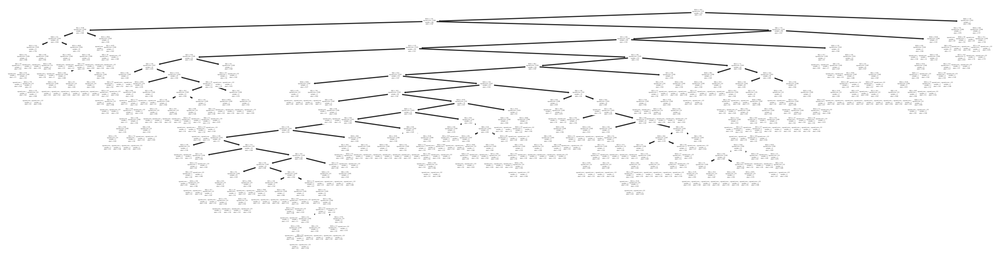

In [151]:
from sklearn.tree import plot_tree
plt.figure(figsize=(16, 4))
plot_tree(best_tree_model);

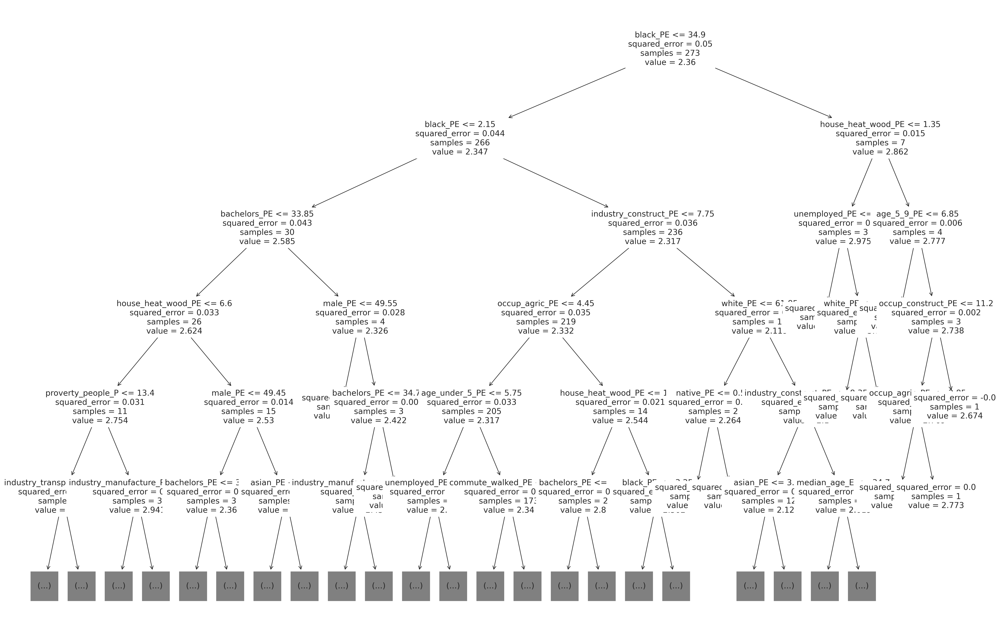

In [152]:
plt.figure(figsize=(30, 20))
plot_tree(best_tree_model, max_depth=5, fontsize=14, feature_names=X_cols);

## Bayesian Regression + PPC Check (Selected features)

In [153]:
X_cols_updated_OVR = [
#  'high_sch_grad_PE',
#  "bachelor's_PE",
#  'unemployed_PE',
 'commute_walked_PE',
#  'commute_worked_home_PE',
#  'occup_construct_PE',
#  'occup_transp_PE',
#  'occup_agric_PE',
#  'industry_construct_PE',
#  'industry_manufacture_PE',
 'industry_transport_PE',
#  'proverty_familiy_PE',
#  'proverty_people_P',
#  'male_PE',
#  'female_PE',
#  'age_under_5_PE',
 'age_5_9_PE',
#  'median_age_E',
#  'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE',
 'log_OVR']

In [154]:
predictor_vars_OVR = [
 'high_sch_grad_PE',
 "bachelors_PE",
 'unemployed_PE',
 'commute_walked_PE',
 'commute_worked_home_PE',
 'occup_construct_PE',
 'occup_transp_PE',
 'occup_agric_PE',
 'industry_construct_PE',
 'industry_manufacture_PE',
 'industry_transport_PE',
 'proverty_familiy_PE',
 'proverty_people_P',
 'male_PE',
 'female_PE',
 'age_under_5_PE',
 'age_5_9_PE',
 'median_age_E',
 'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE', 
 'log_OVR']

## Data Conversion for faster runtime

In [155]:
data_mortality_all_features = data_mortality.loc[:, predictor_vars_OVR].astype('float32')
data_mortality_all_features

,high_sch_grad_PE,bachelors_PE,unemployed_PE,commute_walked_PE,commute_worked_home_PE,occup_construct_PE,occup_transp_PE,occup_agric_PE,industry_construct_PE,industry_manufacture_PE,...,age_5_9_PE,median_age_E,white_PE,black_PE,native_PE,asian_PE,hispanic_PE,house_heat_coal_PE,house_heat_wood_PE,log_OVR
0,31.299999,13.900000,11.8,1.3,2.9,10.5,15.700000,1.9,7.1,13.700000,...,6.5,37.799999,69.500000,26.4,0.6,1.1,3.800000,0.0,1.1,2.476538
1,25.100000,16.700001,11.8,2.0,5.8,8.9,9.400000,1.3,6.6,7.300000,...,7.0,35.900002,79.400002,4.1,4.5,2.7,29.799999,0.0,2.1,2.151762
4,34.599998,13.200000,9.6,1.8,3.0,10.9,16.500000,3.7,6.5,13.900000,...,6.7,37.299999,78.400002,15.9,0.6,1.1,6.300000,0.0,4.4,2.433613
6,20.799999,19.100000,12.8,2.7,5.2,9.4,10.800000,2.4,5.9,10.000000,...,6.8,35.200001,62.400002,6.0,0.8,13.1,37.700001,0.0,1.8,2.397895
9,22.799999,23.400000,9.9,3.0,6.4,9.4,9.100000,2.2,7.6,7.400000,...,7.0,36.000000,83.300003,3.9,1.0,2.6,20.799999,0.1,2.0,2.322388
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2966,25.200001,30.799999,4.4,1.5,5.7,10.6,13.400000,2.9,9.1,8.500000,...,6.9,35.099998,73.400002,12.3,0.5,5.0,39.700001,0.0,0.3,1.960095
2972,23.100000,34.799999,3.2,2.0,7.4,9.4,12.900000,1.7,7.9,9.700000,...,8.0,31.200001,87.300003,1.2,1.1,2.4,14.400000,0.1,1.1,2.240710
2983,23.600000,39.599998,4.0,2.3,5.8,7.8,10.700000,0.8,6.8,7.000000,...,5.9,38.500000,67.000000,19.4,0.3,6.6,9.700000,0.0,1.9,2.312536
2989,22.100000,37.000000,4.6,3.5,6.5,9.6,11.700000,2.6,7.3,9.500000,...,6.0,37.900002,74.199997,4.0,1.4,9.0,13.000000,0.0,3.7,2.251292


In [156]:
data_mortality_selected = data_mortality.loc[:, X_cols_updated_OVR].astype('float32')
data_mortality_selected

,commute_walked_PE,industry_transport_PE,age_5_9_PE,black_PE,native_PE,asian_PE,hispanic_PE,house_heat_coal_PE,house_heat_wood_PE,log_OVR
0,1.3,5.0,6.5,26.4,0.6,1.1,3.800000,0.0,1.1,2.476538
1,2.0,4.9,7.0,4.1,4.5,2.7,29.799999,0.0,2.1,2.151762
4,1.8,5.5,6.7,15.9,0.6,1.1,6.300000,0.0,4.4,2.433613
6,2.7,4.6,6.8,6.0,0.8,13.1,37.700001,0.0,1.8,2.397895
9,3.0,4.5,7.0,3.9,1.0,2.6,20.799999,0.1,2.0,2.322388
...,...,...,...,...,...,...,...,...,...,...
2966,1.5,6.1,6.9,12.3,0.5,5.0,39.700001,0.0,0.3,1.960095
2972,2.0,5.2,8.0,1.2,1.1,2.4,14.400000,0.1,1.1,2.240710
2983,2.3,4.7,5.9,19.4,0.3,6.6,9.700000,0.0,1.9,2.312536
2989,3.5,5.4,6.0,4.0,1.4,9.0,13.000000,0.0,3.7,2.251292


## Feature Transformation

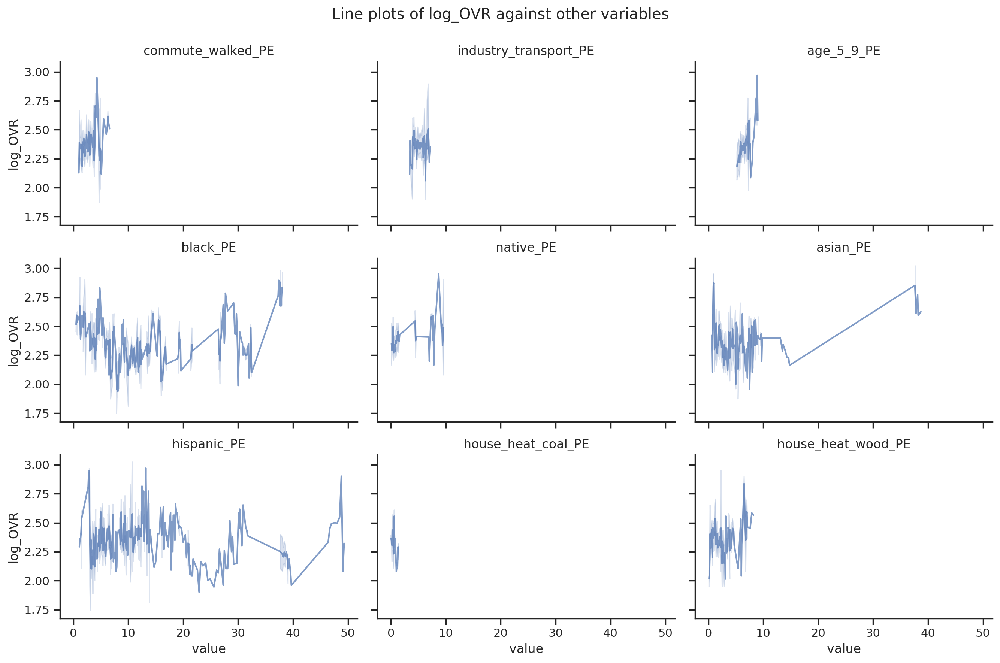

In [157]:
# set up the grid of plots
grid = sns.FacetGrid(data_mortality_selected.melt(id_vars=['log_OVR']), col='variable', col_wrap=3, height=3, aspect=1.5)

# plot each variable against log_OVR in a separate subplot
grid.map(sns.lineplot, 'value', 'log_OVR', alpha=.7)

# add titles to each subplot
titles = data_mortality_selected.columns[:-1]
for ax, title in zip(grid.axes.flat, titles):
    ax.set_title(title)

# adjust spacing and show the plot
plt.subplots_adjust(top=0.9)
grid.fig.suptitle('Line plots of log_OVR against other variables')
plt.show()

In [158]:
for i in range(len(X_cols_updated_OVR)):
    if i <= 2:
        data_mortality_selected[f'log_{X_cols_updated_OVR[i]}'] = np.log(data_mortality_selected[X_cols_updated_OVR[i]])
    elif i <= 6 and i >=3:
         data_mortality_selected[f'boxcox_{X_cols_updated_OVR[i]}'] = boxcox(data_mortality_selected[X_cols_updated_OVR[i]])[0]
    elif i == 7:
        data_mortality_selected[X_cols_updated_OVR[i]] = data_mortality_selected[X_cols_updated_OVR[i]] 
    elif i == 8:
        data_mortality_selected[f'sqrt_{X_cols_updated_OVR[i]}'] = np.sqrt(data_mortality_selected[X_cols_updated_OVR[i]])

In [159]:
data_mortality_selected.columns

Index(['commute_walked_PE', 'industry_transport_PE', 'age_5_9_PE', 'black_PE',
       'native_PE', 'asian_PE', 'hispanic_PE', 'house_heat_coal_PE',
       'house_heat_wood_PE', 'log_OVR', 'log_commute_walked_PE',
       'log_industry_transport_PE', 'log_age_5_9_PE', 'boxcox_black_PE',
       'boxcox_native_PE', 'boxcox_asian_PE', 'boxcox_hispanic_PE',
       'sqrt_house_heat_wood_PE'],
      dtype='object')

## Bayesian flat prior + normal likelihood regression with selected features and no transformation

## 1. Slice: This is a univariate sampler that proposes new parameter values by slicing through the posterior distribution. It can be useful for models with a large number of parameters or when the posterior distribution has narrow regions.
## 2. Low effective samples mean there is signs of autocorrelation, where the same variable are correlated between time intervals (time-series data limitation)
## 3. rhat stats is larger than 1.05 meaning some variables such as intercept not able to converge. Chains did not mixed well (between and within chain variance estimate does not agree)

In [160]:
with pm.Model() as flat_prior_normal_model_selected:
    glm.GLM.from_formula('log_OVR ~ commute_walked_PE + industry_transport_PE + age_5_9_PE + black_PE + native_PE + asian_PE + hispanic_PE + house_heat_coal_PE + house_heat_wood_PE', 
                         data_mortality_selected) 
    trace_flat_normal_selected = pm.sample(draws=1000, cores=4, init='adapt_diag', tune=1000, step=pm.Slice(), random_seed=120)

/tmp/ipykernel_1216/2920388162.py:4: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_flat_normal_selected = pm.sample(draws=1000, cores=4, init='adapt_diag', tune=1000, step=pm.Slice(), random_seed=120)
Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>Slice: [sd]
>Slice: [house_heat_wood_PE]
>Slice: [house_heat_coal_PE]
>Slice: [hispanic_PE]
>Slice: [asian_PE]
>Slice: [native_PE]
>Slice: [black_PE]
>Slice: [age_5_9_PE]
>Slice: [industry_transport_PE]
>Slice: [commute_walked_PE]
>Slice: [Intercept]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 34 seconds.
/opt/conda/lib/python3.9/site-packages/arviz/utils.py:187: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  numba_fn = numba.jit(**self.kwargs)(self.function)
The rhat statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effective samples is smaller than 200 for some parameters.


Got error No model on context stack. trying to find log_likelihood in translation.
/opt/conda/lib/python3.9/site-packages/arviz/data/io_pymc3_3x.py:98: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(
Got error No model on context stack. trying to find log_likelihood in translation.
/opt/conda/lib/python3.9/site-packages/arviz/utils.py:187: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  numba_fn = numba.jit(**self.kwargs)(self.function)


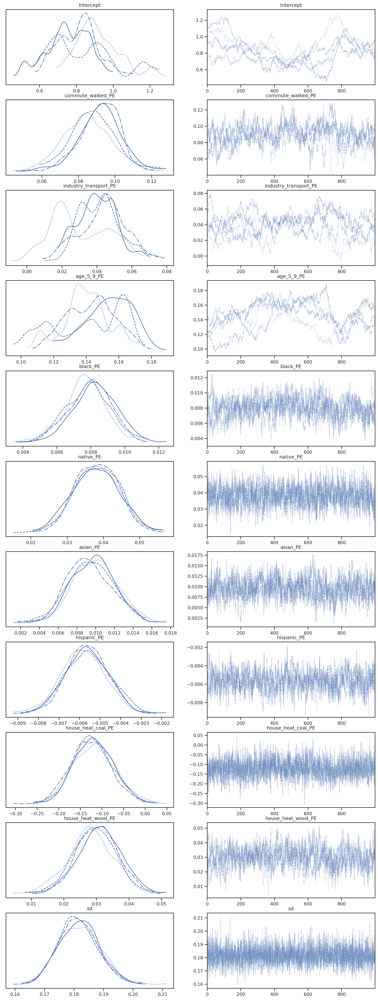

In [161]:
az.plot_trace(trace_flat_normal_selected, figsize=(15, 40));

In [162]:
X_cols_updated_no_OVR = [
#  'high_sch_grad_PE',
#  "bachelor's_PE",
#  'unemployed_PE',
'Intercept',
 'commute_walked_PE',
#  'commute_worked_home_PE',
#  'occup_construct_PE',
#  'occup_transp_PE',
#  'occup_agric_PE',
#  'industry_construct_PE',
#  'industry_manufacture_PE',
 'industry_transport_PE',
#  'proverty_familiy_PE',
#  'proverty_people_P',
#  'male_PE',
#  'female_PE',
#  'age_under_5_PE',
 'age_5_9_PE',
#  'median_age_E',
#  'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']

Got error No model on context stack. trying to find log_likelihood in translation.
/opt/conda/lib/python3.9/site-packages/arviz/data/io_pymc3_3x.py:98: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(


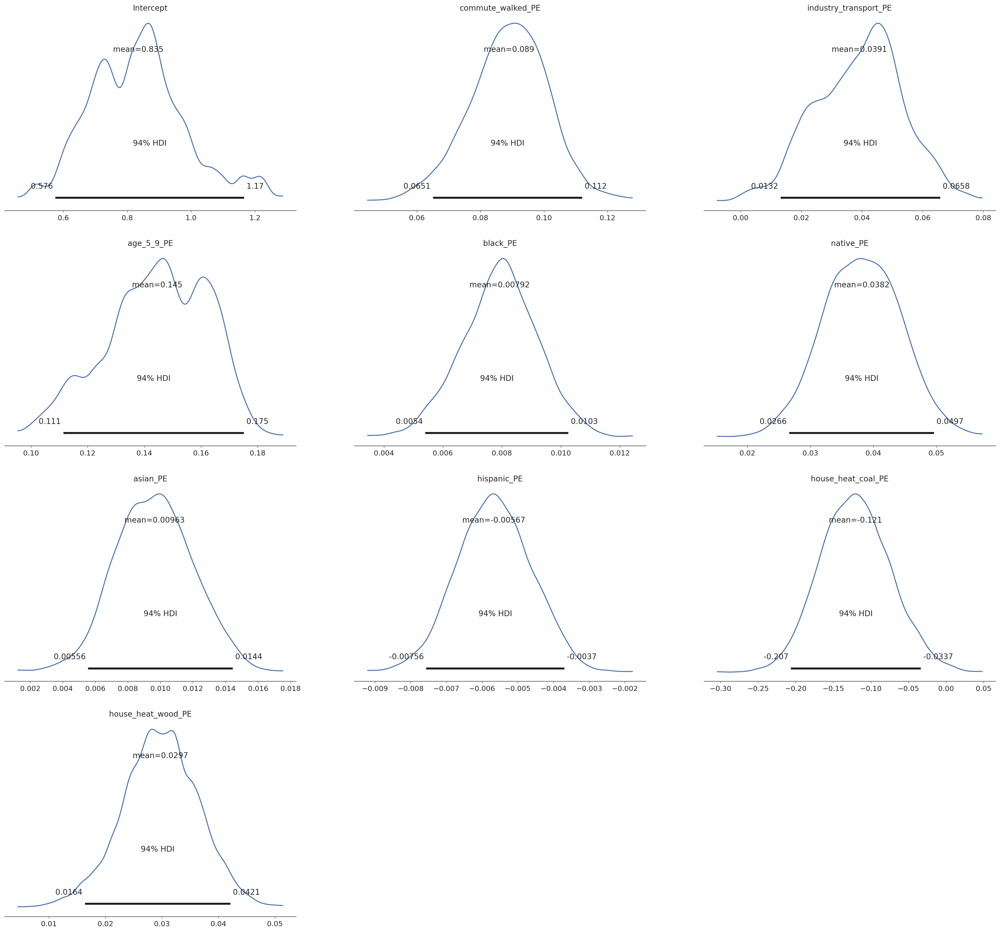

In [163]:
# Plot the posterior distribution for the intercept and Temp_Anomaly coefficients
az.plot_posterior(trace_flat_normal_selected, X_cols_updated_no_OVR, round_to = 3)
plt.show()

## Transformed Bayesian Flat prior regression

In [164]:
with pm.Model() as flat_prior_normal_model_selected_transformed:
    glm.GLM.from_formula('log_OVR ~ log_commute_walked_PE + log_industry_transport_PE + log_age_5_9_PE + boxcox_black_PE + boxcox_native_PE + boxcox_asian_PE + house_heat_coal_PE + boxcox_hispanic_PE + house_heat_coal_PE + sqrt_house_heat_wood_PE', 
                         data_mortality_selected) 
    trace_flat_normal_selected_transformed = pm.sample(draws=1000, cores=4, init='adapt_diag', tune=1000, step=pm.Slice(), random_seed=120)

/tmp/ipykernel_1216/731092406.py:4: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_flat_normal_selected_transformed = pm.sample(draws=1000, cores=4, init='adapt_diag', tune=1000, step=pm.Slice(), random_seed=120)
Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>Slice: [sd]
>Slice: [sqrt_house_heat_wood_PE]
>Slice: [boxcox_hispanic_PE]
>Slice: [house_heat_coal_PE]
>Slice: [boxcox_asian_PE]
>Slice: [boxcox_native_PE]
>Slice: [boxcox_black_PE]
>Slice: [log_age_5_9_PE]
>Slice: [log_industry_transport_PE]
>Slice: [log_commute_walked_PE]
>Slice: [Intercept]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 35 seconds.
The rhat statistic is larger than 1.4 for some parameters. The sampler did not converge.
The estimated number of effective samples is smaller than 200 for some parameters.


Got error No model on context stack. trying to find log_likelihood in translation.
/opt/conda/lib/python3.9/site-packages/arviz/data/io_pymc3_3x.py:98: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(
Got error No model on context stack. trying to find log_likelihood in translation.


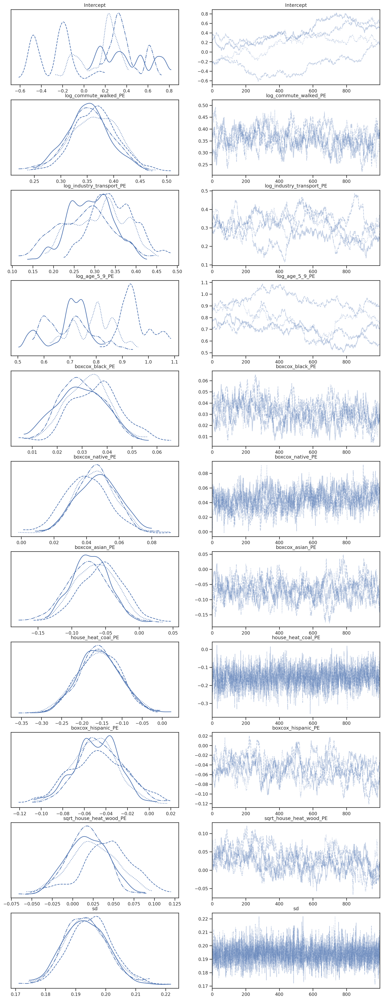

In [165]:
az.plot_trace(trace_flat_normal_selected_transformed, figsize=(15, 40));

In [166]:
new_X_cols = [
'log_commute_walked_PE', 'log_industry_transport_PE', 'log_age_5_9_PE',
       'boxcox_black_PE', 'boxcox_native_PE', 'boxcox_asian_PE','house_heat_coal_PE', 'sqrt_house_heat_wood_PE',
       'boxcox_hispanic_PE']

Got error No model on context stack. trying to find log_likelihood in translation.
/opt/conda/lib/python3.9/site-packages/arviz/data/io_pymc3_3x.py:98: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(


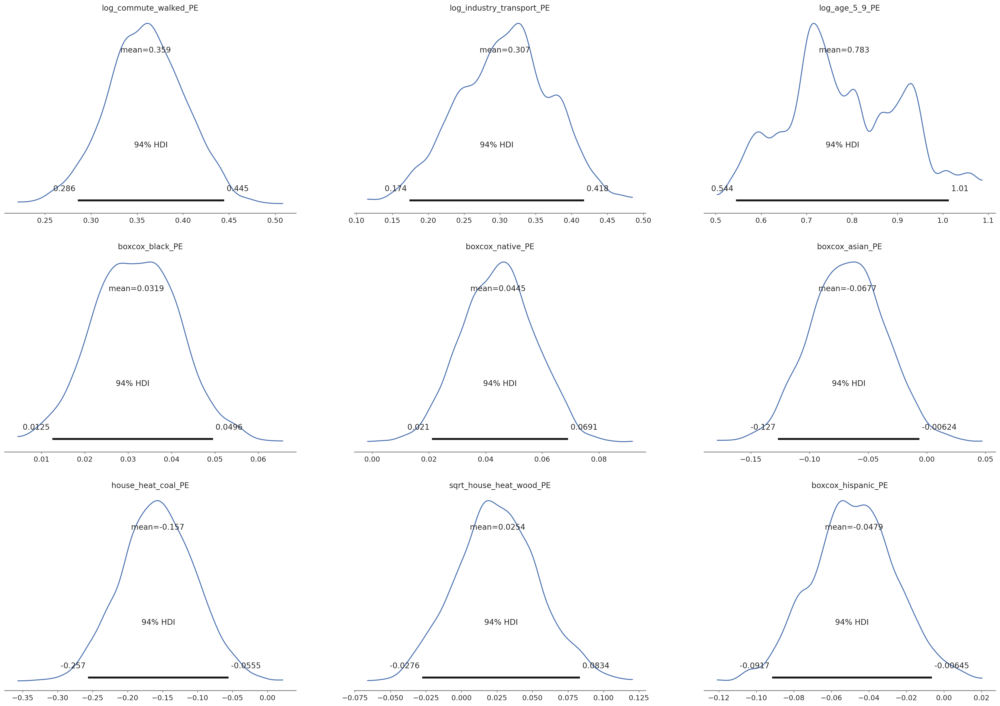

In [167]:
# Plot the posterior distribution for the intercept and Temp_Anomaly coefficients
az.plot_posterior(trace_flat_normal_selected_transformed, new_X_cols, round_to = 3)
plt.show()

## Bayesian Flat Prior Regression with all Features, not transformed

In [168]:
with pm.Model() as flat_prior_normal_model_all:
    glm.GLM.from_formula('log_OVR ~ high_sch_grad_PE + bachelors_PE + unemployed_PE + commute_walked_PE + commute_worked_home_PE + occup_construct_PE + occup_transp_PE + occup_agric_PE + industry_construct_PE + industry_manufacture_PE + industry_transport_PE + proverty_familiy_PE + proverty_people_P + male_PE + female_PE + age_under_5_PE + age_5_9_PE + median_age_E + white_PE + black_PE + native_PE + asian_PE + hispanic_PE + house_heat_coal_PE + house_heat_wood_PE',
                         data_mortality_all_features) 
    trace_flat_prior_normal_all = pm.sample(draws=1000, cores=4, init='adapt_diag', tune=1000, step=pm.Slice(), random_seed=120)

/tmp/ipykernel_1216/1192410725.py:4: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_flat_prior_normal_all = pm.sample(draws=1000, cores=4, init='adapt_diag', tune=1000, step=pm.Slice(), random_seed=120)
Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>Slice: [sd]
>Slice: [house_heat_wood_PE]
>Slice: [house_heat_coal_PE]
>Slice: [hispanic_PE]
>Slice: [asian_PE]
>Slice: [native_PE]
>Slice: [black_PE]
>Slice: [white_PE]
>Slice: [median_age_E]
>Slice: [age_5_9_PE]
>Slice: [age_under_5_PE]
>Slice: [female_PE]
>Slice: [male_PE]
>Slice: [proverty_people_P]
>Slice: [proverty_familiy_PE]
>Slice: [industry_transport_PE]
>Slice: [industry_manufacture_PE]
>Slice: [industry_construct_PE]
>Slice: [occup_agric_PE]
>Slice: [occup_transp_PE]
>Slice: [occup_construct_PE]
>Slice: [commute_worked_home_PE]
>Slice: [com

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 153 seconds.
The rhat statistic is larger than 1.4 for some parameters. The sampler did not converge.
The estimated number of effective samples is smaller than 200 for some parameters.


Got error No model on context stack. trying to find log_likelihood in translation.
/opt/conda/lib/python3.9/site-packages/arviz/data/io_pymc3_3x.py:98: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(
Got error No model on context stack. trying to find log_likelihood in translation.
/opt/conda/lib/python3.9/site-packages/arviz/plots/traceplot.py:212: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (27), generating only 20 plots
  warnings.warn(


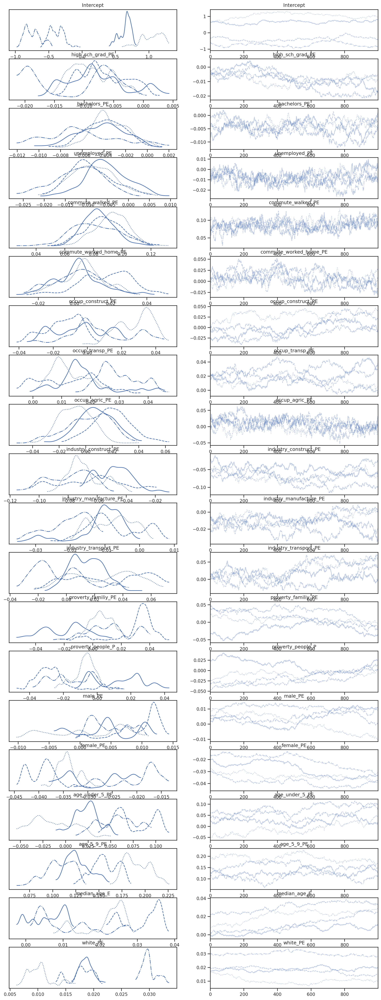

In [169]:
az.plot_trace(trace_flat_prior_normal_all, figsize=(15, 40));

In [170]:
predictor_vars_no_OVR = [
 'high_sch_grad_PE',
 'bachelors_PE',
 'unemployed_PE',
 'commute_walked_PE',
 'commute_worked_home_PE',
 'occup_construct_PE',
 'occup_transp_PE',
 'occup_agric_PE',
 'industry_construct_PE',
 'industry_manufacture_PE',
 'industry_transport_PE',
 'proverty_familiy_PE',
 'proverty_people_P',
 'male_PE',
 'female_PE',
 'age_under_5_PE',
 'age_5_9_PE',
 'median_age_E',
 'white_PE',
 'black_PE',
 'native_PE',
 'asian_PE',
 'hispanic_PE',
 'house_heat_coal_PE',
 'house_heat_wood_PE']

Got error No model on context stack. trying to find log_likelihood in translation.
/opt/conda/lib/python3.9/site-packages/arviz/data/io_pymc3_3x.py:98: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(


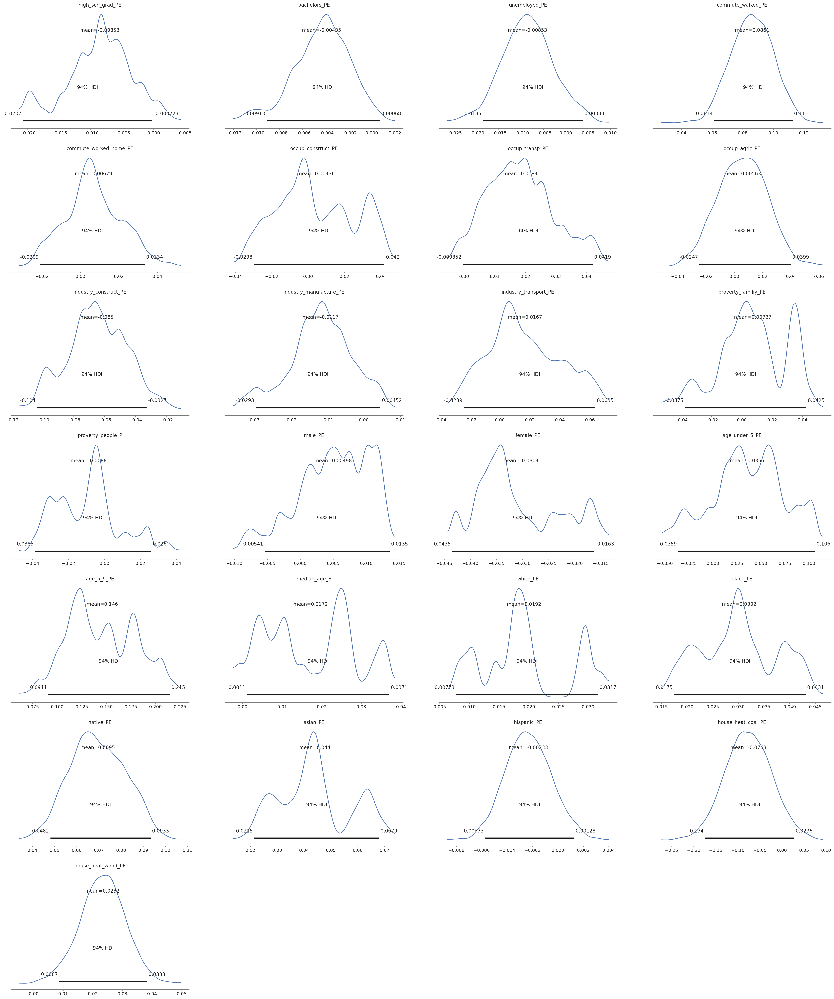

In [171]:
# Plot the posterior distribution for the intercept and Temp_Anomaly coefficients
az.plot_posterior(trace_flat_prior_normal_all, predictor_vars_no_OVR, round_to = 3)
plt.show()

## Flat Prior Normal Likelihood Bayesian Regression Posterior Predictive Checks (Selected Features)

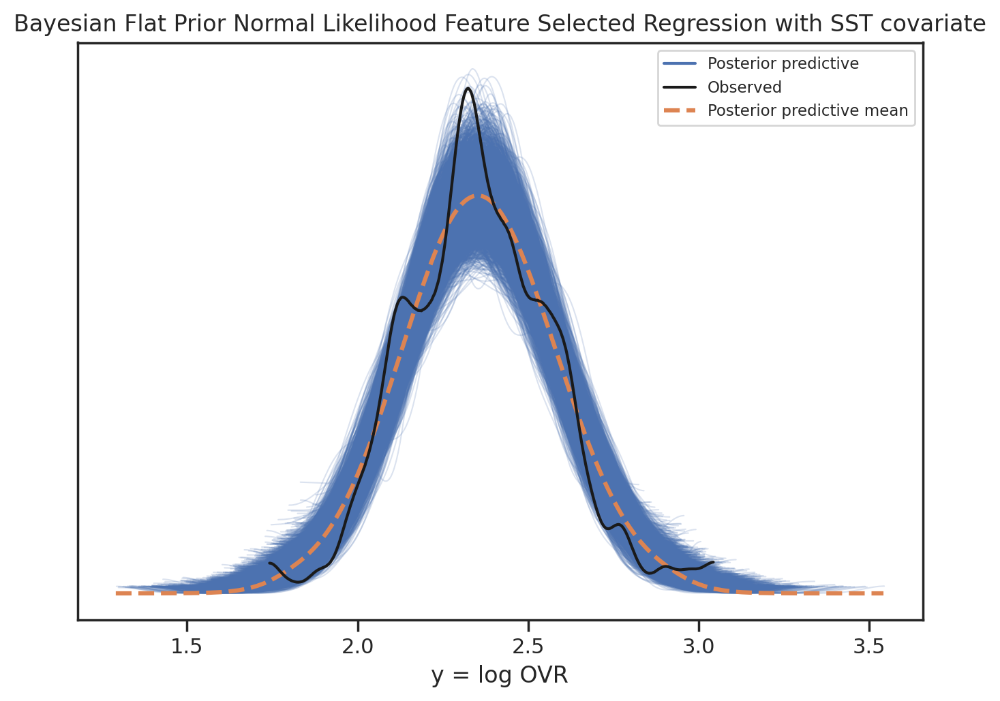

In [172]:
# Do not modify
# Sample C'_i|X_i 
with flat_prior_normal_model_selected:
    normal_ppc = pm.sample_posterior_predictive(trace_flat_normal_selected)
    normal_ppc['y'] = normal_ppc['y'] + 0.0
    normal_ppc = az.from_pymc3(trace_flat_normal_selected, posterior_predictive=normal_ppc)
        
# Plot PPC samples

az.plot_ppc(normal_ppc)
plt.xlabel('y = log OVR')
plt.title('Bayesian Flat Prior Normal Likelihood Feature Selected Regression with SST covariate')
# plt.axis([-2, 45, -0.01, 0.2])

plt.show()

## Flat Prior Normal Likelihood Bayesian Regression Posterior Predictive Checks (Transformed Selected Features)

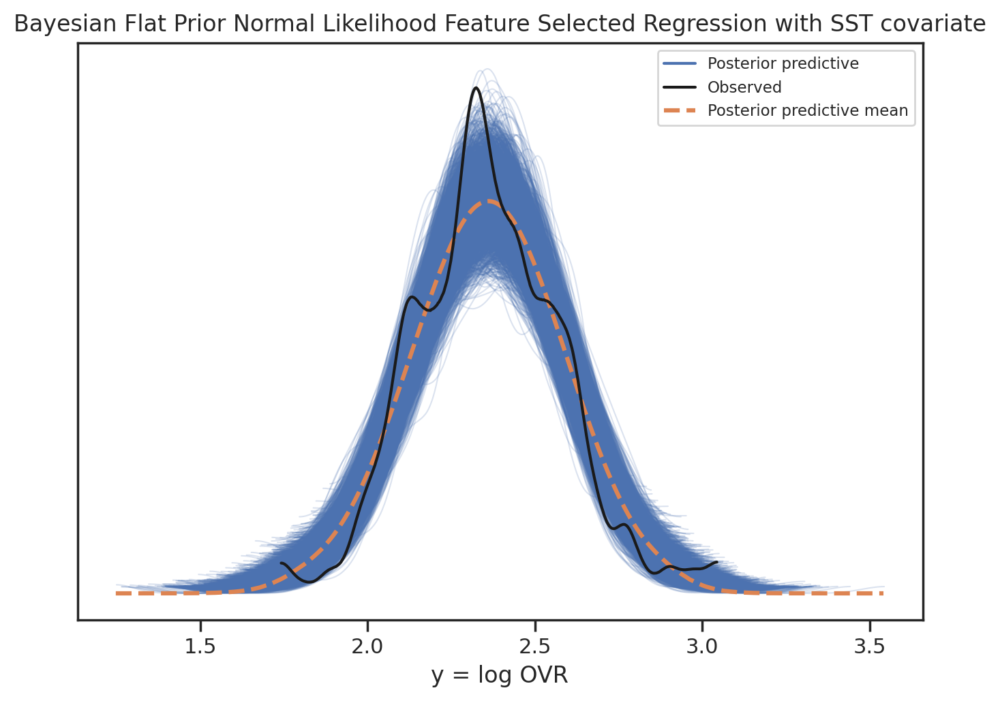

In [173]:
# Do not modify
# Sample C'_i|X_i 
with flat_prior_normal_model_selected_transformed:
    normal_ppc = pm.sample_posterior_predictive(trace_flat_normal_selected_transformed)
    normal_ppc['y'] = normal_ppc['y'] + 0.0
    normal_ppc = az.from_pymc3(trace_flat_normal_selected_transformed, posterior_predictive=normal_ppc)
        
# Plot PPC samples

az.plot_ppc(normal_ppc)
plt.xlabel('y = log OVR')
plt.title('Bayesian Flat Prior Normal Likelihood Feature Selected Regression with SST covariate')
# plt.axis([-2, 45, -0.01, 0.2])

plt.show()

## Flat Prior Normal Likelihood Bayesian Regression Posterior Predictive Checks (All Features)

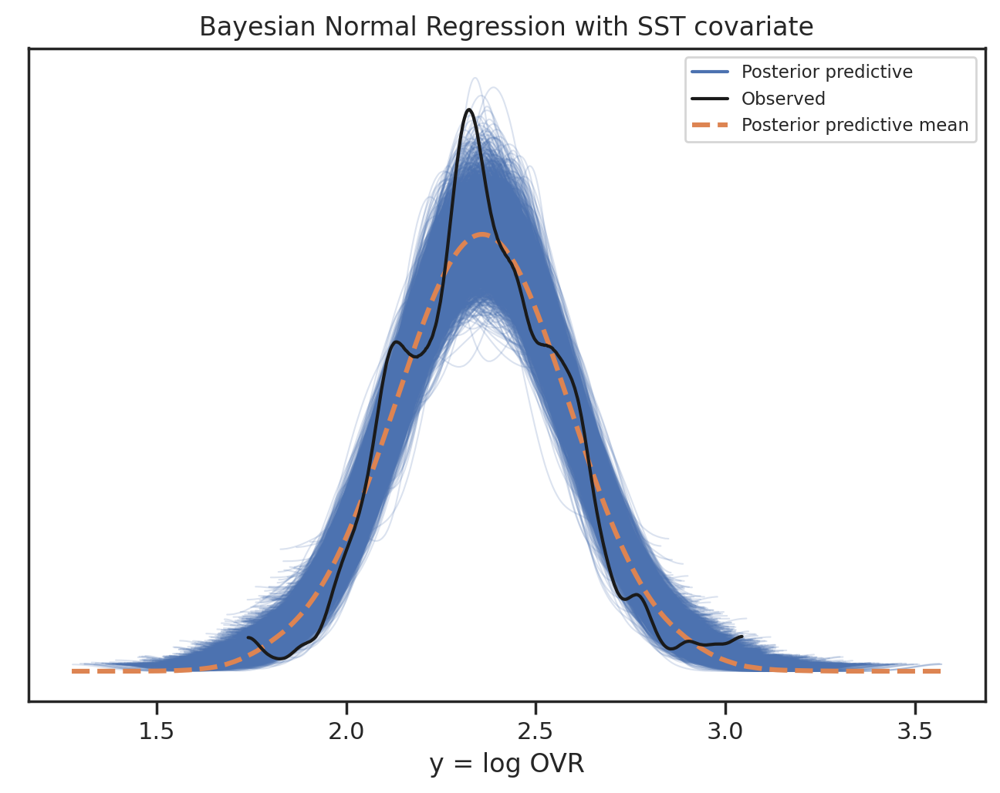

In [174]:
# Do not modify
# Sample C'_i|X_i 
with flat_prior_normal_model_all:
    normal_ppc = pm.sample_posterior_predictive(trace_flat_prior_normal_all)
    normal_ppc['y'] = normal_ppc['y'] + 0.0
    normal_ppc = az.from_pymc3(trace_flat_prior_normal_all, posterior_predictive=normal_ppc)
        
# Plot PPC samples
az.plot_ppc(normal_ppc)
plt.xlabel('y = log OVR')
plt.title('Bayesian Normal Regression with SST covariate')
# plt.axis([-2, 45, -0.01, 0.2])

plt.show()